# Lending Club Case study


In [1]:
#Import all the necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

## Data Loading and Data Understanding

In [2]:
#read the dataset and check the first five rows
df = pd.read_csv('loan.csv')
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


Observation:
    
There are a lot of columns with null data, checking the total null values in each column and removing columns with more than 50% null values

In [3]:
#Check the shape of the dataframe
df.shape

(39717, 111)

In [4]:
#Check the number of null values in the columns
df.isnull().sum()

id                                0
member_id                         0
loan_amnt                         0
funded_amnt                       0
funded_amnt_inv                   0
                              ...  
tax_liens                        39
tot_hi_cred_lim               39717
total_bal_ex_mort             39717
total_bc_limit                39717
total_il_high_credit_limit    39717
Length: 111, dtype: int64

In [5]:
#Set the notebook to display all the rows and columns
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [6]:
#Check the number of null values in the columns
df.isnull().sum()

id                                    0
member_id                             0
loan_amnt                             0
funded_amnt                           0
funded_amnt_inv                       0
term                                  0
int_rate                              0
installment                           0
grade                                 0
sub_grade                             0
emp_title                          2459
emp_length                         1075
home_ownership                        0
annual_inc                            0
verification_status                   0
issue_d                               0
loan_status                           0
pymnt_plan                            0
url                                   0
desc                              12940
purpose                               0
title                                11
zip_code                              0
addr_state                            0
dti                                   0


In [7]:
#Check the shape of the dataframe before dropping any columns
df.shape

(39717, 111)

In [8]:
#Since there are many completely null columns, dropping the 'Columns' with 'All' the values as Null
df = df.dropna(axis=1, how='all')
df.shape

(39717, 57)

In [9]:
#Check the number of null values in the columns again
df.isnull().sum()

id                                0
member_id                         0
loan_amnt                         0
funded_amnt                       0
funded_amnt_inv                   0
term                              0
int_rate                          0
installment                       0
grade                             0
sub_grade                         0
emp_title                      2459
emp_length                     1075
home_ownership                    0
annual_inc                        0
verification_status               0
issue_d                           0
loan_status                       0
pymnt_plan                        0
url                               0
desc                          12940
purpose                           0
title                            11
zip_code                          0
addr_state                        0
dti                               0
delinq_2yrs                       0
earliest_cr_line                  0
inq_last_6mths              

In [10]:
# Dropping columns with approximately more than 50% 'null' values.
df = df.drop(axis=1, columns=['mths_since_last_delinq','mths_since_last_record','next_pymnt_d'])
df.isnull().sum()

id                                0
member_id                         0
loan_amnt                         0
funded_amnt                       0
funded_amnt_inv                   0
term                              0
int_rate                          0
installment                       0
grade                             0
sub_grade                         0
emp_title                      2459
emp_length                     1075
home_ownership                    0
annual_inc                        0
verification_status               0
issue_d                           0
loan_status                       0
pymnt_plan                        0
url                               0
desc                          12940
purpose                           0
title                            11
zip_code                          0
addr_state                        0
dti                               0
delinq_2yrs                       0
earliest_cr_line                  0
inq_last_6mths              

For now the dataset has columns with more than atleast 50% data, so we can begin pre-processing the data and later handle the missing values in the columns.

## Pre-Processing the data

In [11]:
df.shape

(39717, 54)

In [12]:
#Removing the data of loan_status 'Current' as the data of such users will be insufficient for analysis
df = df[~(df['loan_status']=='Current')]
df.shape

(38577, 54)

In [13]:
#Check if there are any duplicate ID's
df.id.is_unique

True

In [14]:
#Check if there are any duplicate members
df.member_id.is_unique

True

Observation:

As the ID and member ID are different for all the users, the rows are unique.

In [15]:
#As the applicants are unique, drop the id and member_id column
df = df.drop(axis=1, columns=['id','member_id'])

In [16]:
df.shape

(38577, 52)

In [17]:
#Check the datatype of all the columns
df.dtypes

loan_amnt                       int64
funded_amnt                     int64
funded_amnt_inv               float64
term                           object
int_rate                       object
installment                   float64
grade                          object
sub_grade                      object
emp_title                      object
emp_length                     object
home_ownership                 object
annual_inc                    float64
verification_status            object
issue_d                        object
loan_status                    object
pymnt_plan                     object
url                            object
desc                           object
purpose                        object
title                          object
zip_code                       object
addr_state                     object
dti                           float64
delinq_2yrs                     int64
earliest_cr_line               object
inq_last_6mths                  int64
open_acc    

#### Examining data and performing data type conversions on necessary columns

##### Columns without any null values:

loan_amnt, funded_amnt,funded_amnt_inv are integer/float values and very important for the analysis. As there are no null values, they are not to be tampered with. 

In [18]:
#term - The number of months should be of integer type but available as 'Object'

#Checking the column data
df.term

0         36 months
1         60 months
2         36 months
3         36 months
5         36 months
6         60 months
7         36 months
8         60 months
9         60 months
10        60 months
11        36 months
12        36 months
13        36 months
14        36 months
15        36 months
16        36 months
17        36 months
18        36 months
19        36 months
20        60 months
21        36 months
22        36 months
23        36 months
24        36 months
25        36 months
26        36 months
27        60 months
28        36 months
29        36 months
30        36 months
31        36 months
33        36 months
34        36 months
35        36 months
36        36 months
37        36 months
38        36 months
40        36 months
41        36 months
42        36 months
43        36 months
44        36 months
45        36 months
46        36 months
47        36 months
48        36 months
49        36 months
50        36 months
51        36 months
52        36 months


In [19]:
#Since the 'term' information as a continous type data would be very helpful for analysis, converting it.

#Defining a function to remove 'months' and converting the value to integer.
def term_as_int(val):
    return int(val.replace(" months",""))

#Applying the function on the column data
df.term = df.term.apply(term_as_int)

#Checking the column data
df.term

0        36
1        60
2        36
3        36
5        36
6        60
7        36
8        60
9        60
10       60
11       36
12       36
13       36
14       36
15       36
16       36
17       36
18       36
19       36
20       60
21       36
22       36
23       36
24       36
25       36
26       36
27       60
28       36
29       36
30       36
31       36
33       36
34       36
35       36
36       36
37       36
38       36
40       36
41       36
42       36
43       36
44       36
45       36
46       36
47       36
48       36
49       36
50       36
51       36
52       36
53       36
54       36
55       60
56       60
57       36
58       36
59       36
60       60
61       60
62       60
63       36
64       60
65       36
66       60
67       36
68       60
69       36
70       60
71       36
72       36
73       36
74       36
75       36
76       36
77       60
78       36
79       60
80       60
81       36
82       36
83       36
84       36
85       36
87  

In [20]:
#int_rate - The values should be of float type.

#Checking the column data
df.int_rate

0        10.65%
1        15.27%
2        15.96%
3        13.49%
5         7.90%
6        15.96%
7        18.64%
8        21.28%
9        12.69%
10       14.65%
11       12.69%
12       13.49%
13        9.91%
14       10.65%
15       16.29%
16       15.27%
17        6.03%
18       11.71%
19        6.03%
20       15.27%
21       12.42%
22       11.71%
23       11.71%
24       11.71%
25        9.91%
26       14.27%
27       16.77%
28       11.71%
29       11.71%
30        7.51%
31        7.90%
33        8.90%
34       15.96%
35       10.65%
36        9.91%
37        7.90%
38       12.42%
40        7.51%
41        7.90%
42       18.25%
43       16.77%
44        6.03%
45        9.91%
46        8.90%
47       10.65%
48        6.03%
49        6.62%
50        9.91%
51        9.91%
52       10.65%
53       15.96%
54        9.91%
55       19.91%
56       19.91%
57       12.42%
58       10.65%
59       16.77%
60       12.69%
61       17.27%
62       14.65%
63       16.77%
64       10.65%
65      

In [21]:
#Removing the '%'symbol and converting the data to float type 
df.int_rate = df.int_rate.apply(lambda x: float(x.replace('%', '').strip()))

#Checking the new column data
print(df.int_rate)
df.int_rate.describe()

0        10.65
1        15.27
2        15.96
3        13.49
5         7.90
6        15.96
7        18.64
8        21.28
9        12.69
10       14.65
11       12.69
12       13.49
13        9.91
14       10.65
15       16.29
16       15.27
17        6.03
18       11.71
19        6.03
20       15.27
21       12.42
22       11.71
23       11.71
24       11.71
25        9.91
26       14.27
27       16.77
28       11.71
29       11.71
30        7.51
31        7.90
33        8.90
34       15.96
35       10.65
36        9.91
37        7.90
38       12.42
40        7.51
41        7.90
42       18.25
43       16.77
44        6.03
45        9.91
46        8.90
47       10.65
48        6.03
49        6.62
50        9.91
51        9.91
52       10.65
53       15.96
54        9.91
55       19.91
56       19.91
57       12.42
58       10.65
59       16.77
60       12.69
61       17.27
62       14.65
63       16.77
64       10.65
65       10.65
66       17.27
67       14.27
68       21.28
69       1

count    38577.000000
mean        11.932219
std          3.691327
min          5.420000
25%          8.940000
50%         11.710000
75%         14.380000
max         24.400000
Name: int_rate, dtype: float64

In [22]:
#Checking the contents in grade column
df.grade.value_counts()

B    11675
A    10045
C     7834
D     5085
E     2663
F      976
G      299
Name: grade, dtype: int64

No unwanted values observed in grade column

In [23]:
#Checking the contents in sub_grade column
df.sub_grade.value_counts()

A4    2873
B3    2825
A5    2715
B5    2615
B4    2437
C1    2055
B2    2001
C2    1931
A3    1810
B1    1797
A2    1508
C3    1488
D2    1286
C4    1206
C5    1154
A1    1139
D3    1116
D1     931
D4     918
D5     834
E1     722
E2     614
E3     516
E4     424
E5     387
F1     305
F2     233
F3     174
F4     151
F5     113
G1      94
G2      77
G4      54
G3      45
G5      29
Name: sub_grade, dtype: int64

No unwanted values observed in sub_grade column

In [24]:
#Checking contents of home_ownership
df.home_ownership.value_counts()

RENT        18480
MORTGAGE    17021
OWN          2975
OTHER          98
NONE            3
Name: home_ownership, dtype: int64

'None' is not an acceptable value in the column, As there are only 3 such records with 'None' value - Assuming that the type of ownership is unknown and moving such records into 'Other' type

In [25]:
#Replacing 'None' with 'OTHER'
df.home_ownership = df.home_ownership.apply(lambda x: "OTHER" if x == "NONE" else x)

#Making sure the changes are reflected
df.home_ownership.value_counts()

RENT        18480
MORTGAGE    17021
OWN          2975
OTHER         101
Name: home_ownership, dtype: int64

In [26]:
#Checking verification_status
df.verification_status.value_counts()

Not Verified       16694
Verified           12206
Source Verified     9677
Name: verification_status, dtype: int64

In [27]:
#issue_d - 

#Checking the column data
df.issue_d

0        Dec-11
1        Dec-11
2        Dec-11
3        Dec-11
5        Dec-11
6        Dec-11
7        Dec-11
8        Dec-11
9        Dec-11
10       Dec-11
11       Dec-11
12       Dec-11
13       Dec-11
14       Dec-11
15       Dec-11
16       Dec-11
17       Dec-11
18       Dec-11
19       Dec-11
20       Dec-11
21       Dec-11
22       Dec-11
23       Dec-11
24       Dec-11
25       Dec-11
26       Dec-11
27       Dec-11
28       Dec-11
29       Dec-11
30       Dec-11
31       Dec-11
33       Dec-11
34       Dec-11
35       Dec-11
36       Dec-11
37       Dec-11
38       Dec-11
40       Dec-11
41       Dec-11
42       Dec-11
43       Dec-11
44       Dec-11
45       Dec-11
46       Dec-11
47       Dec-11
48       Dec-11
49       Dec-11
50       Dec-11
51       Dec-11
52       Dec-11
53       Dec-11
54       Dec-11
55       Dec-11
56       Dec-11
57       Dec-11
58       Dec-11
59       Dec-11
60       Dec-11
61       Dec-11
62       Dec-11
63       Dec-11
64       Dec-11
65      

In [28]:
#Convert all the dates in the dataset into a single format
df.issue_d = pd.to_datetime(df.issue_d, format='%b-%y', yearfirst=False)

#Checking the newcolumn data
df.issue_d

0       2011-12-01
1       2011-12-01
2       2011-12-01
3       2011-12-01
5       2011-12-01
6       2011-12-01
7       2011-12-01
8       2011-12-01
9       2011-12-01
10      2011-12-01
11      2011-12-01
12      2011-12-01
13      2011-12-01
14      2011-12-01
15      2011-12-01
16      2011-12-01
17      2011-12-01
18      2011-12-01
19      2011-12-01
20      2011-12-01
21      2011-12-01
22      2011-12-01
23      2011-12-01
24      2011-12-01
25      2011-12-01
26      2011-12-01
27      2011-12-01
28      2011-12-01
29      2011-12-01
30      2011-12-01
31      2011-12-01
33      2011-12-01
34      2011-12-01
35      2011-12-01
36      2011-12-01
37      2011-12-01
38      2011-12-01
40      2011-12-01
41      2011-12-01
42      2011-12-01
43      2011-12-01
44      2011-12-01
45      2011-12-01
46      2011-12-01
47      2011-12-01
48      2011-12-01
49      2011-12-01
50      2011-12-01
51      2011-12-01
52      2011-12-01
53      2011-12-01
54      2011-12-01
55      2011

In [29]:
#Checking loan_status
df.loan_status.value_counts()

Fully Paid     32950
Charged Off     5627
Name: loan_status, dtype: int64

As we dropped the applicants with 'current' loan status previously, we are only left with charged-off abd fully-paid applicants.

In [30]:
#checking pymnt_plan
df.pymnt_plan.value_counts()

n    38577
Name: pymnt_plan, dtype: int64

As pymnt_plan is only 'n' for all the rows including fully_paid type and charged_off type, planning to drop this column.

In [31]:
#checking url
df.url.describe()

count                                                 38577
unique                                                38577
top       https://lendingclub.com/browse/loanDetail.acti...
freq                                                      1
Name: url, dtype: object

Since the url column has unique values and also insignificant for the analysis, planning to drop the column.

In [32]:
#Checking purpose
df.purpose.value_counts()

debt_consolidation    18055
credit_card            5027
other                  3865
home_improvement       2875
major_purchase         2150
small_business         1754
car                    1499
wedding                 926
medical                 681
moving                  576
vacation                375
house                   367
educational             325
renewable_energy        102
Name: purpose, dtype: int64

purpose column doesnt have any unwanted values

In [33]:
#Checking zip_code
df.zip_code.value_counts()

100xx    583
945xx    531
112xx    502
606xx    493
070xx    455
900xx    446
021xx    383
300xx    383
926xx    366
750xx    356
941xx    355
921xx    341
917xx    340
331xx    337
770xx    316
117xx    293
113xx    274
852xx    267
913xx    265
330xx    249
891xx    242
080xx    235
925xx    232
334xx    229
902xx    229
201xx    223
920xx    221
951xx    219
980xx    217
303xx    217
200xx    211
104xx    205
928xx    202
923xx    200
301xx    195
940xx    195
950xx    193
802xx    193
212xx    184
554xx    184
600xx    183
956xx    182
088xx    181
773xx    181
191xx    180
787xx    177
207xx    175
850xx    174
752xx    174
604xx    169
328xx    169
981xx    167
601xx    167
853xx    159
333xx    159
190xx    150
060xx    149
064xx    149
208xx    149
958xx    146
481xx    145
327xx    143
774xx    142
210xx    140
028xx    137
114xx    132
432xx    132
760xx    132
018xx    130
890xx    129
336xx    128
800xx    126
152xx    126
972xx    126
322xx    126
782xx    125
076xx    123

Since zip_code isn't completely unique or doesn't have any unwanted values, not modifying it.

In [34]:
#checking addr_state
df.addr_state.value_counts()

CA    6949
NY    3698
FL    2781
TX    2659
NJ    1790
IL    1478
PA    1468
VA    1369
GA    1359
MA    1297
OH    1178
MD    1023
AZ     849
WA     818
CO     766
NC     750
CT     726
MI     704
MO     670
MN     605
NV     479
SC     459
WI     440
AL     435
OR     435
LA     427
KY     311
OK     287
KS     255
UT     252
AR     235
DC     211
RI     194
NM     183
WV     172
NH     166
HI     166
DE     113
MT      83
WY      80
AK      78
SD      62
VT      53
MS      19
TN      17
IN       9
ID       6
IA       5
NE       5
ME       3
Name: addr_state, dtype: int64

No unwanted values in addr_state

As dti is unique for each user but useable for analysis, not modifying it.

In [35]:
#Checking delinq_2yrs
df.delinq_2yrs.value_counts()

0     34386
1      3207
2       673
3       212
4        60
5        21
6        10
7         4
8         2
9         1
11        1
Name: delinq_2yrs, dtype: int64

In [36]:
#earliest_cr_line-
#Convert all the dates in the dataset into a single format
df.earliest_cr_line = pd.to_datetime(df.earliest_cr_line, format='%b-%y', yearfirst=False)

#Checking the newcolumn data
df.earliest_cr_line

0       1985-01-01
1       1999-04-01
2       2001-11-01
3       1996-02-01
5       2004-11-01
6       2005-07-01
7       2007-01-01
8       2004-04-01
9       2004-09-01
10      1998-01-01
11      1989-10-01
12      2004-04-01
13      2003-07-01
14      1991-05-01
15      2007-09-01
16      1998-10-01
17      1993-08-01
18      2003-10-01
19      2001-01-01
20      1997-11-01
21      1983-02-01
22      1985-07-01
23      2003-04-01
24      2001-06-01
25      2002-02-01
26      2003-10-01
27      2003-10-01
28      1984-08-01
29      2006-11-01
30      1987-12-01
31      1981-11-01
33      2005-04-01
34      2007-10-01
35      2005-07-01
36      2000-12-01
37      2004-11-01
38      2007-04-01
40      2003-01-01
41      1994-03-01
42      1998-09-01
43      2004-06-01
44      1995-11-01
45      1999-07-01
46      1995-06-01
47      2006-11-01
48      1992-09-01
49      2002-01-01
50      1992-04-01
51      1999-07-01
52      2004-04-01
53      2006-10-01
54      2000-05-01
55      1998

In [37]:
#checking inq_last_6mths
df.inq_last_6mths.value_counts()

0    18709
1    10660
2     5654
3     2983
4      316
5      144
6       63
7       34
8       14
Name: inq_last_6mths, dtype: int64

In [38]:
#Checking open_acc
df.open_acc.value_counts()

7     3909
6     3846
8     3814
9     3607
5     3111
10    3097
11    2666
4     2300
12    2198
13    1855
3     1470
14    1427
15    1146
16     908
17     716
2      596
18     516
19     384
20     281
21     235
22     137
23      93
24      75
25      53
26      34
28      24
27      22
30      15
29      13
31       7
34       5
35       4
32       3
33       3
36       2
39       1
38       1
44       1
41       1
42       1
Name: open_acc, dtype: int64

No unwanted values in open_acc.

In [39]:
#Checking pub_rec
df.pub_rec.value_counts()

0    36507
1     2013
2       48
3        7
4        2
Name: pub_rec, dtype: int64

No Unwanted values found in pub_rec

revol_bal is a column with unique data for each user, usable for analysis.

In [40]:
#revol_util
print(df.revol_util)

#revol_util can be used for analysis by converting it to float type.
df.revol_util = df.revol_util.apply(lambda x: float(str(x).replace('%', '').strip()))

#Checking the newcolumn data
df.revol_util

0        83.70%
1         9.40%
2        98.50%
3           21%
5        28.30%
6        85.60%
7        87.50%
8        32.60%
9        36.50%
10       20.60%
11       67.10%
12       91.70%
13       43.10%
14       55.50%
15       81.50%
16       70.20%
17          16%
18       37.73%
19       23.10%
20       85.60%
21       90.30%
22       82.40%
23       91.80%
24       29.70%
25       93.90%
26       57.60%
27       59.50%
28       37.70%
29       59.10%
30       86.90%
31       27.40%
33       29.30%
34       60.50%
35       57.20%
36       13.30%
37       50.40%
38       66.50%
40       18.10%
41          21%
42       98.10%
43          99%
44       32.50%
45       13.40%
46       62.10%
47       52.30%
48       19.50%
49       36.40%
50       63.70%
51          62%
52       92.90%
53       90.80%
54       52.10%
55       97.60%
56       75.10%
57       72.70%
58       59.10%
59       91.20%
60       58.90%
61       58.90%
62       57.40%
63       66.90%
64       30.10%
65      

0        83.70
1         9.40
2        98.50
3        21.00
5        28.30
6        85.60
7        87.50
8        32.60
9        36.50
10       20.60
11       67.10
12       91.70
13       43.10
14       55.50
15       81.50
16       70.20
17       16.00
18       37.73
19       23.10
20       85.60
21       90.30
22       82.40
23       91.80
24       29.70
25       93.90
26       57.60
27       59.50
28       37.70
29       59.10
30       86.90
31       27.40
33       29.30
34       60.50
35       57.20
36       13.30
37       50.40
38       66.50
40       18.10
41       21.00
42       98.10
43       99.00
44       32.50
45       13.40
46       62.10
47       52.30
48       19.50
49       36.40
50       63.70
51       62.00
52       92.90
53       90.80
54       52.10
55       97.60
56       75.10
57       72.70
58       59.10
59       91.20
60       58.90
61       58.90
62       57.40
63       66.90
64       30.10
65       45.90
66       70.80
67       83.40
68       73.90
69       7

total_acc is a column with unique data for every user.

In [41]:
#Checking initial_list_status
df.initial_list_status.value_counts()

f    38577
Name: initial_list_status, dtype: int64

Since initial_list_status is 'f' for both fully paid type and charged off type applicants, planning to drop this column

In [42]:
#checking out_prncp
df.out_prncp.describe()

count    38577.0
mean         0.0
std          0.0
min          0.0
25%          0.0
50%          0.0
75%          0.0
max          0.0
Name: out_prncp, dtype: float64

Since out_prncp is '0.0' for all the applicants, planning to drop it.

In [43]:
#Checking out_prncp_inv
df.out_prncp_inv.value_counts()

0.0    38577
Name: out_prncp_inv, dtype: int64

Since out_prncp_inv also has '0.0' for all the applicants, planning to drop it.

total_pymnt, total_pymnt_inv, total_rec_prncp, total_rec_int, total_rec_late_fee are all columns with fixed data, need not be modified.

recoveries and collection_recovery_fee are both scenarios for already charged-off customers, since they are out of scope for the analysis, planning to drop them.

In [44]:
#last_pymnt_d-
#Convert all the dates in the dataset into a single format
df.last_pymnt_d = pd.to_datetime(df.last_pymnt_d, format='%b-%y', yearfirst=False)

#Checking the newcolumn data
df.last_pymnt_d

0       2015-01-01
1       2013-04-01
2       2014-06-01
3       2015-01-01
5       2015-01-01
6       2016-05-01
7       2015-01-01
8       2012-04-01
9       2012-11-01
10      2013-06-01
11      2013-09-01
12      2012-07-01
13      2015-01-01
14      2013-10-01
15      2015-01-01
16      2015-01-01
17      2013-05-01
18      2015-02-01
19      2012-07-01
20      2015-08-01
21      2013-09-01
22      2015-01-01
23      2013-10-01
24      2012-10-01
25      2012-09-01
26             NaT
27      2012-12-01
28      2013-04-01
29      2014-12-01
30      2015-01-01
31      2013-08-01
33      2015-01-01
34      2015-01-01
35      2015-01-01
36      2013-11-01
37      2014-01-01
38      2014-04-01
40      2015-01-01
41      2015-01-01
42      2015-01-01
43      2015-01-01
44      2012-07-01
45      2015-01-01
46      2014-08-01
47      2015-01-01
48      2012-07-01
49      2015-01-01
50      2014-10-01
51      2015-01-01
52      2015-01-01
53      2012-08-01
54      2014-07-01
55      2014

last_pymnt_amnt is a column with unique data.

In [45]:
#last_credit_pull_d
#Convert all the dates in the dataset into a single format
df.last_credit_pull_d = pd.to_datetime(df.last_credit_pull_d, format='%b-%y', yearfirst=False)

collections_12_mths_ex_med is also related to recovery of already charged off customer. Since it is out of scope for analysis, dropping it.

In [46]:
#Checking policy_code
df.policy_code.value_counts()

1    38577
Name: policy_code, dtype: int64

Since policy_code has only one value '1' both for fully paid and charged off customers, dropping it.

In [47]:
#Checking application_type
df.application_type.value_counts()

INDIVIDUAL    38577
Name: application_type, dtype: int64

Since application_type has only one value 'INDIVIDUAL' both for fully paid and charged off customers, dropping it.

In [48]:
#Checking acc_now_delinq
df.acc_now_delinq.value_counts()

0    38577
Name: acc_now_delinq, dtype: int64

Since acc_now_delinq has only one value '0' both for fully paid and charged off customers, dropping it.

In [49]:
#Checking chargeoff_within_12_mths
df.chargeoff_within_12_mths.value_counts()

0.0    38521
Name: chargeoff_within_12_mths, dtype: int64

Since chargeoff_within_12_mths has only one value '0.0' both for fully paid and charged off customers, dropping it.

In [50]:
#Checking delinq_amnt
df.delinq_amnt.value_counts()

0    38577
Name: delinq_amnt, dtype: int64

Since delinq_amnt has only one value '0' both for fully paid and charged off customers, dropping it.

In [51]:
#Checking tax_liens
df.tax_liens.value_counts()

0.0    38538
Name: tax_liens, dtype: int64

Since tax_liens has only one value '0.0' both for fully paid and charged off customers, dropping it.

In [52]:
# Dropping all the planned columns above
df = df.drop(axis=1, columns=['pymnt_plan', 'url', 'initial_list_status', 'out_prncp', 'out_prncp_inv', 'recoveries',
                              'collection_recovery_fee', 'collections_12_mths_ex_med', 'policy_code', 
                              'application_type', 'acc_now_delinq', 'chargeoff_within_12_mths', 'delinq_amnt', 'tax_liens'])

#Making sure that the changes are reflected
df.shape

(38577, 38)

In [53]:
#Checking columns available for analysis
df.columns

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'grade', 'sub_grade', 'emp_title', 'emp_length',
       'home_ownership', 'annual_inc', 'verification_status', 'issue_d',
       'loan_status', 'desc', 'purpose', 'title', 'zip_code', 'addr_state',
       'dti', 'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'total_pymnt',
       'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'last_pymnt_d', 'last_pymnt_amnt',
       'last_credit_pull_d', 'pub_rec_bankruptcies'],
      dtype='object')

## Missing value treatment

##### Columns with null values:

In [54]:
#Check the number of null values in the columns
df.isnull().sum()

loan_amnt                   0
funded_amnt                 0
funded_amnt_inv             0
term                        0
int_rate                    0
installment                 0
grade                       0
sub_grade                   0
emp_title                2386
emp_length               1033
home_ownership              0
annual_inc                  0
verification_status         0
issue_d                     0
loan_status                 0
desc                    12527
purpose                     0
title                      11
zip_code                    0
addr_state                  0
dti                         0
delinq_2yrs                 0
earliest_cr_line            0
inq_last_6mths              0
open_acc                    0
pub_rec                     0
revol_bal                   0
revol_util                 50
total_acc                   0
total_pymnt                 0
total_pymnt_inv             0
total_rec_prncp             0
total_rec_int               0
total_rec_

There are a total of '8' columns with missing values, checking them for missing value treatment:

In [55]:
# Checking emp_title
df.emp_title

0                                                      NaN
1                                                    Ryder
2                                                      NaN
3                                      AIR RESOURCES BOARD
5                                     Veolia Transportaton
6                                Southern Star Photography
7                                          MKC Accounting 
8                                                      NaN
9                                                Starbucks
10                                   Southwest Rural metro
11                                                    UCLA
12                     Va. Dept of Conservation/Recreation
13                                                  Target
14                                                   SFMTA
15                                Internal revenue Service
16                                       Chin's Restaurant
17                                                Durace

In [56]:
#Checking the values in emp_title
df.emp_title.value_counts()

US Army                                                                           131
Bank of America                                                                   107
IBM                                                                                65
AT&T                                                                               57
Kaiser Permanente                                                                  56
USAF                                                                               52
Wells Fargo                                                                        52
UPS                                                                                52
US Air Force                                                                       51
Walmart                                                                            45
United States Air Force                                                            42
Lockheed Martin                                       

There are 2386 values stated as NAN. For analysis purpose, inputting 'Not Disclosed' for such records.

In [57]:
#Giving 'Not Disclosed' as the value for NAN type.
df.emp_title = df.emp_title.fillna('Not Disclosed')

In [58]:
#Making sure that no null values exist in the column
df.emp_title.isnull().sum()

0

In [59]:
#Checking emp_length
df.emp_length

0        10+ years
1         < 1 year
2        10+ years
3        10+ years
5          3 years
6          8 years
7          9 years
8          4 years
9         < 1 year
10         5 years
11       10+ years
12        < 1 year
13         3 years
14         3 years
15        < 1 year
16         4 years
17       10+ years
18          1 year
19         6 years
20         3 years
21       10+ years
22       10+ years
23         5 years
24          1 year
25         2 years
26         9 years
27         2 years
28       10+ years
29        < 1 year
30         7 years
31         5 years
33         2 years
34         7 years
35       10+ years
36         2 years
37          1 year
38          1 year
40         4 years
41       10+ years
42         9 years
43       10+ years
44       10+ years
45         6 years
46       10+ years
47         6 years
48       10+ years
49         5 years
50         8 years
51         9 years
52        < 1 year
53         4 years
54          1 year
55         7

In [60]:
#Checking the values in the column emp_length
df.emp_length.value_counts()

10+ years    8488
< 1 year     4508
2 years      4291
3 years      4012
4 years      3342
5 years      3194
1 year       3169
6 years      2168
7 years      1711
8 years      1435
9 years      1226
Name: emp_length, dtype: int64

There are 1033 empty records with undisclosed emp_length. 
Considering them as un-employed i.e., 0 years - Pushing them into < 1 year bucket.

In [61]:
#Inputting < 1 year for NAN values in emp_length column
df.emp_length = df.emp_length.fillna('< 1 year')

In [62]:
#Checking the values in the column emp_length
df.emp_length.value_counts()

10+ years    8488
< 1 year     5541
2 years      4291
3 years      4012
4 years      3342
5 years      3194
1 year       3169
6 years      2168
7 years      1711
8 years      1435
9 years      1226
Name: emp_length, dtype: int64

In [63]:
#Making sure that no null values exist in the column
df.emp_length.isnull().sum()

0

In [64]:
#Checking desc column
df.desc

0          Borrower added on 12/22/11 > I need to upgra...
1          Borrower added on 12/22/11 > I plan to use t...
2                                                      NaN
3          Borrower added on 12/21/11 > to pay for prop...
5                                                      NaN
6          Borrower added on 12/18/11 > I am planning o...
7          Borrower added on 12/16/11 > Downpayment for...
8          Borrower added on 12/21/11 > I own a small h...
9          Borrower added on 12/16/11 > I'm trying to b...
10         Borrower added on 12/15/11 > I had recived a...
11                                                     NaN
12         Borrower added on 12/15/11 > Plan to pay off...
13         Borrower added on 12/19/11 > I intend to pay...
14                                                     NaN
15                                                     NaN
16                                                     NaN
17         Borrower added on 12/15/11 > Payoff other le.

Clearly, 12527 values are not a less number to tamper and also description doesn't seem to be a required field and can be un-disclosed. So inputting 'Not Disclosed' for null values.

In [65]:
#Giving 'Not Disclosed' as the value for NAN type.
df.desc = df.desc.fillna('Not Disclosed')

In [66]:
#Making sure that no null values exist in the column
df.desc.isnull().sum()

0

In [67]:
#Checking title column
df.title

0                                                 Computer
1                                                     bike
2                                     real estate business
3                                                 personel
5                    My wedding loan I promise to pay back
6                                                     Loan
7                                          Car Downpayment
8                     Expand Business & Buy Debt Portfolio
9                              Building my credit history.
10                              High intrest Consolidation
11                                           Consolidation
12                                                 freedom
13                                           citicard fund
14                                              Other Loan
15                                 Debt Consolidation Loan
16                                                    Home
17                                                 Holid

In [68]:
#Checking the values
df.title.value_counts()

Debt Consolidation                                                                  2090
Debt Consolidation Loan                                                             1620
Personal Loan                                                                        641
Consolidation                                                                        491
debt consolidation                                                                   478
Credit Card Consolidation                                                            348
Home Improvement                                                                     345
Debt consolidation                                                                   322
Small Business Loan                                                                  305
Credit Card Loan                                                                     301
Personal                                                                             301
Consolidation Loan   

We can notice that there are many duplicates with spelling correction or similar phrases available 
For example: 

Debt Consolidation is similar to Consolidate my last outstanding debts, Dext Consolidation, Need debt consolidation!, Debt Consolidatio/Payoff, Seeking to Consolidate High Interest Deb, Credit Card Consoidation, Credit card debt consolidation 2010, Consolidate My Credit Cards & Save Money, Debt_consolidation_20110307 etc.,

Making it impossible to seggregate the title.

In [69]:
#Chdcking for number of unique values
df.title.describe()

count                  38566
unique                 19297
top       Debt Consolidation
freq                    2090
Name: title, dtype: object

There are 19297 different types of titles available, and are unusable for analysis in this case.

Though there are only 11 missing values, dropping this column as the values are too unique for analysis.

In [70]:
#Dropping the title column
df = df.drop(axis=1, columns=['title'])

In [71]:
# Checking revol_utilcolumn
df.revol_util

0        83.70
1         9.40
2        98.50
3        21.00
5        28.30
6        85.60
7        87.50
8        32.60
9        36.50
10       20.60
11       67.10
12       91.70
13       43.10
14       55.50
15       81.50
16       70.20
17       16.00
18       37.73
19       23.10
20       85.60
21       90.30
22       82.40
23       91.80
24       29.70
25       93.90
26       57.60
27       59.50
28       37.70
29       59.10
30       86.90
31       27.40
33       29.30
34       60.50
35       57.20
36       13.30
37       50.40
38       66.50
40       18.10
41       21.00
42       98.10
43       99.00
44       32.50
45       13.40
46       62.10
47       52.30
48       19.50
49       36.40
50       63.70
51       62.00
52       92.90
53       90.80
54       52.10
55       97.60
56       75.10
57       72.70
58       59.10
59       91.20
60       58.90
61       58.90
62       57.40
63       66.90
64       30.10
65       45.90
66       70.80
67       83.40
68       73.90
69       7

Since there are only 50 such values marked as NaN, we can replace it with the mean/median, so as to aid with the analysis. Also there is lesser need for an exact value in this case. 

Check for outliers to choose between mean and median.

In [72]:
#Checking the median of the revol_util column
df.revol_util.describe()

count    38527.000000
mean        48.702777
std         28.364741
min          0.000000
25%         25.200000
50%         49.100000
75%         72.300000
max         99.900000
Name: revol_util, dtype: float64

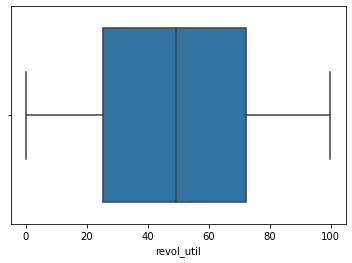

In [73]:
#Plotting a box plot to check outliers
sns.boxplot(df.revol_util)
plt.show()

Since there are no outliers, mean can be considered instead of median.

In [74]:
#Checking the type of the column
df.revol_util.dtype

dtype('float64')

In [75]:
#Filling in '48.70' for the missing values
df.revol_util = df.revol_util.fillna(48.70)

In [76]:
#Checking the type of the column
df.revol_util.dtype

dtype('float64')

In [77]:
#Making sure that no null values exist in the column
df.revol_util.isnull().sum()

0

In [78]:
# Checking last_pymnt_d column
df.last_pymnt_d

0       2015-01-01
1       2013-04-01
2       2014-06-01
3       2015-01-01
5       2015-01-01
6       2016-05-01
7       2015-01-01
8       2012-04-01
9       2012-11-01
10      2013-06-01
11      2013-09-01
12      2012-07-01
13      2015-01-01
14      2013-10-01
15      2015-01-01
16      2015-01-01
17      2013-05-01
18      2015-02-01
19      2012-07-01
20      2015-08-01
21      2013-09-01
22      2015-01-01
23      2013-10-01
24      2012-10-01
25      2012-09-01
26             NaT
27      2012-12-01
28      2013-04-01
29      2014-12-01
30      2015-01-01
31      2013-08-01
33      2015-01-01
34      2015-01-01
35      2015-01-01
36      2013-11-01
37      2014-01-01
38      2014-04-01
40      2015-01-01
41      2015-01-01
42      2015-01-01
43      2015-01-01
44      2012-07-01
45      2015-01-01
46      2014-08-01
47      2015-01-01
48      2012-07-01
49      2015-01-01
50      2014-10-01
51      2015-01-01
52      2015-01-01
53      2012-08-01
54      2014-07-01
55      2014

Filling in 'NA' for the missing dates as last payment date is not to be tampered with. As the applicants with no last payment date or last payment date close to loan issue date are generally charged-off applicants.

In [79]:
#Filling in 'NA' for the missing dates 
df.last_pymnt_d = df.last_pymnt_d.fillna('NA')

In [80]:
#Making sure that no null values exist in the column
df.last_pymnt_d.isnull().sum()

0

In [81]:
#Checking last_credit_pull_d column
df.last_credit_pull_d

0       2016-05-01
1       2013-09-01
2       2016-05-01
3       2016-04-01
5       2016-01-01
6       2016-05-01
7       2014-12-01
8       2012-08-01
9       2013-03-01
10      2015-12-01
11      2013-08-01
12      2012-11-01
13      2016-05-01
14      2014-03-01
15      2016-05-01
16      2015-04-01
17      2014-05-01
18      2015-07-01
19      2016-02-01
20      2016-03-01
21      2016-05-01
22      2016-05-01
23      2014-03-01
24      2013-03-01
25      2012-09-01
26      2016-05-01
27      2013-05-01
28      2016-05-01
29      2015-01-01
30      2014-12-01
31      2016-02-01
33      2016-05-01
34      2014-12-01
35      2016-05-01
36      2016-01-01
37      2016-05-01
38      2016-05-01
40      2014-12-01
41      2016-05-01
42      2016-05-01
43      2015-12-01
44      2012-06-01
45      2016-04-01
46      2014-12-01
47      2016-04-01
48      2016-04-01
49      2016-04-01
50      2015-03-01
51      2016-05-01
52      2014-12-01
53      2012-12-01
54      2016-03-01
55      2016

Since there are only two missing values, will not make it 'NA' this time.
Instead, impute the missing values with some value from the data(eg. mode)

In [82]:
#Checking the frequesncy
df.last_credit_pull_d.describe()

count                   38575
unique                    106
top       2016-05-01 00:00:00
freq                     9333
first     2007-05-01 00:00:00
last      2016-05-01 00:00:00
Name: last_credit_pull_d, dtype: object

Since 2016-05-01 has a frequency of 9333, imputing the two missing values with 2016-05-01 

In [83]:
#Replacing null values with most repeated value
df.last_credit_pull_d = df.last_credit_pull_d.fillna('2016-05-01 00:00:00')

In [84]:
#Making sure that no null values exist in the column
df.last_credit_pull_d.isnull().sum()

0

In [85]:
#Checking pub_rec_bankruptcies
df.pub_rec_bankruptcies

0        0.0
1        0.0
2        0.0
3        0.0
5        0.0
6        0.0
7        0.0
8        0.0
9        0.0
10       0.0
11       0.0
12       0.0
13       0.0
14       0.0
15       0.0
16       0.0
17       0.0
18       0.0
19       0.0
20       0.0
21       0.0
22       0.0
23       0.0
24       0.0
25       0.0
26       0.0
27       0.0
28       0.0
29       0.0
30       0.0
31       0.0
33       0.0
34       0.0
35       0.0
36       0.0
37       0.0
38       0.0
40       0.0
41       0.0
42       0.0
43       0.0
44       0.0
45       0.0
46       0.0
47       0.0
48       0.0
49       0.0
50       0.0
51       0.0
52       0.0
53       0.0
54       0.0
55       0.0
56       0.0
57       0.0
58       0.0
59       0.0
60       0.0
61       0.0
62       0.0
63       0.0
64       0.0
65       0.0
66       1.0
67       0.0
68       0.0
69       0.0
70       1.0
71       0.0
72       0.0
73       0.0
74       0.0
75       0.0
76       0.0
77       1.0
78       0.0
79       0.0

There are a lot of missing values towards the end of the data.

Check the 75 percentile data to replace the appropriate values.

In [86]:
#Checking the percentile data
df.pub_rec_bankruptcies.describe()

count    37880.000000
mean         0.043479
std          0.204583
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          2.000000
Name: pub_rec_bankruptcies, dtype: float64

In [87]:
#Checking the values available in the column
df.pub_rec_bankruptcies.value_counts()

0.0    36238
1.0     1637
2.0        5
Name: pub_rec_bankruptcies, dtype: int64

Replacing the 697 missing values with 0.0 as almost all the values have 0.0 and also the 75% is also 0.0

In [88]:
#Imputing the missing values
df.pub_rec_bankruptcies = df.pub_rec_bankruptcies.fillna(0.0)

In [89]:
#Making sure that no null values exist in the column
df.pub_rec_bankruptcies.isnull().sum()

0

In [90]:
#Checking for missing values in the entire dataset
df.isnull().sum()

loan_amnt               0
funded_amnt             0
funded_amnt_inv         0
term                    0
int_rate                0
installment             0
grade                   0
sub_grade               0
emp_title               0
emp_length              0
home_ownership          0
annual_inc              0
verification_status     0
issue_d                 0
loan_status             0
desc                    0
purpose                 0
zip_code                0
addr_state              0
dti                     0
delinq_2yrs             0
earliest_cr_line        0
inq_last_6mths          0
open_acc                0
pub_rec                 0
revol_bal               0
revol_util              0
total_acc               0
total_pymnt             0
total_pymnt_inv         0
total_rec_prncp         0
total_rec_int           0
total_rec_late_fee      0
last_pymnt_d            0
last_pymnt_amnt         0
last_credit_pull_d      0
pub_rec_bankruptcies    0
dtype: int64

In [91]:
df.dtypes

loan_amnt                        int64
funded_amnt                      int64
funded_amnt_inv                float64
term                             int64
int_rate                       float64
installment                    float64
grade                           object
sub_grade                       object
emp_title                       object
emp_length                      object
home_ownership                  object
annual_inc                     float64
verification_status             object
issue_d                 datetime64[ns]
loan_status                     object
desc                            object
purpose                         object
zip_code                        object
addr_state                      object
dti                            float64
delinq_2yrs                      int64
earliest_cr_line        datetime64[ns]
inq_last_6mths                   int64
open_acc                         int64
pub_rec                          int64
revol_bal                

In [92]:
#Check number of rows and columns present
df.shape

(38577, 37)

## Outlier Treatment

Now we need to start identifying and removing extreme values or __outliers__ from our dataset. These values can tilt our analysis and often provide us with a biased perspective of the data available. The best visualisation to use to detect Outliers would be the box plot.


##### Plotting box plots for all the required variables for analysis:

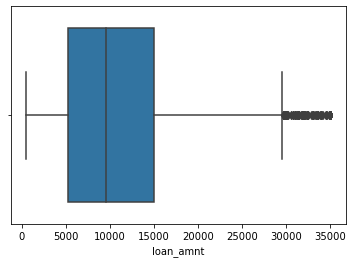

In [93]:
# loan_amnt-
sns.boxplot(df.loan_amnt)
plt.show()

Clearly, there are a bunch of values above the upper extreme, that create bias to the analysis.

In [94]:
#Calculating the quantile information
q3 = df.loan_amnt.quantile(0.75)
q1 = df.loan_amnt.quantile(0.25)

iqr = q3-q1

print(q3,q1,iqr)

15000.0 5300.0 9700.0


In [95]:
#Identifying extremes
upper_extreme = q3+1.5*iqr
lower_extreme = q1-1.5*iqr
print(upper_extreme,lower_extreme)

29550.0 -9250.0


As inferred from the box plot, we can see no values below '0', and from the business perspective there can be no loan amount below '0' in practical scenario, so we only consider upper_extreme.

In [96]:
#Removing records outside upper_extreme
df = df[~(df.loan_amnt >= upper_extreme)]

In [97]:
#Checking number of rows and columns present
df.shape

(37488, 37)

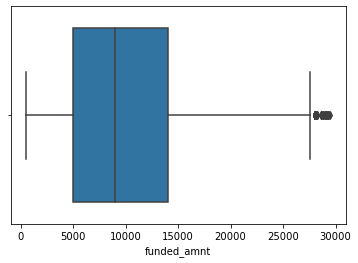

In [98]:
#funded_amnt
sns.boxplot(df.funded_amnt)
plt.show()

Clearly, there are outliers outside the upper extreme. calculating and removing them :

In [99]:
#Calculating the quantile information
q3 = df.funded_amnt.quantile(0.75)
q1 = df.funded_amnt.quantile(0.25)

iqr = q3-q1

print(q3,q1,iqr)

#Identifying extremes
upper_extreme = q3+1.5*iqr
print(upper_extreme)

14050.0 5000.0 9050.0
27625.0


In [100]:
#Removing records outside upper_extreme
df = df[~(df.funded_amnt >= upper_extreme)]

In [101]:
#Checking number of rows and columns present
df.shape

(37327, 37)

'funded_amnt_inv' has no relationship with the customers, either defaulters or fully- paid applicants when funded_amnt is already present. So not considering that column for analysis.

'term' either has 36 or 60 as values, no need of outlier treatment

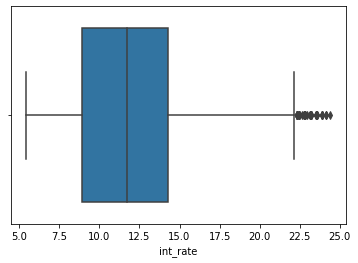

In [102]:
#int_rate
sns.boxplot(df.int_rate)
plt.show()

As there are outliers above upper_extreme, removing them:

In [103]:
#Calculating the quantile information
q3 = df.int_rate.quantile(0.75)
q1 = df.int_rate.quantile(0.25)

iqr = q3-q1

print(q3,q1,iqr)

#Identifying extremes
upper_extreme = q3+1.5*iqr
print(upper_extreme)

14.27 8.9 5.369999999999999
22.325


In [104]:
#Removing records outside upper_extreme
df = df[~(df.int_rate >= upper_extreme)]

In [105]:
#Checking number of rows and columns present
df.shape

(37263, 37)

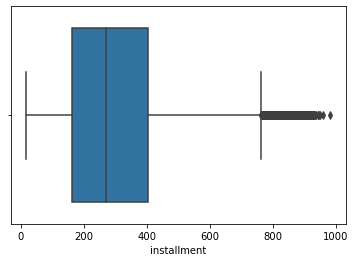

In [106]:
#installment
sns.boxplot(df.installment)
plt.show()

In [107]:
#Calculating the quantile information
q3 = df.installment.quantile(0.75)
q1 = df.installment.quantile(0.25)

iqr = q3-q1

print(q3,q1,iqr)

#Identifying extremes
upper_extreme = q3+1.5*iqr
print(upper_extreme)

403.15 163.11 240.03999999999996
763.2099999999999


In [108]:
#Removing records outside upper_extreme
df = df[~(df.installment >= upper_extreme)]

In [109]:
#Checking number of rows and columns present
df.shape

(36213, 37)

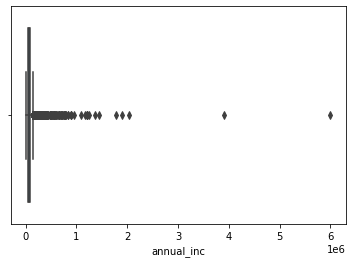

In [110]:
#annual_inc
sns.boxplot(df.annual_inc)
plt.show()

There are outliers with very high annual income, these needs to be removed to avoid bias

There cant be income below '0', so there's no need to consider lower extreme

In [111]:
#Calculating the quantile information
q3 = df.annual_inc.quantile(0.75)
q1 = df.annual_inc.quantile(0.25)

iqr = q3-q1

print(q3,q1,iqr)

#Identifying extremes
upper_extreme = q3+1.5*iqr
print(upper_extreme)

79000.0 40000.0 39000.0
137500.0


In [112]:
#Removing records outside upper_extreme
df = df[~(df.annual_inc >= upper_extreme)]

In [113]:
#Checking number of rows and columns present
df.shape

(34639, 37)

<function matplotlib.pyplot.show(close=None, block=None)>

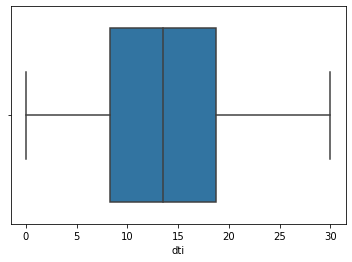

In [114]:
#Checking dti column
sns.boxplot(df.dti)
plt.show

'dti' column doesnot have any outliers

## Exploratory Data Analysis

### Univariate Analysis

In [115]:
#loan_amnt
df.loan_amnt.describe()

count    34639.000000
mean      9733.883051
std       5803.498376
min        500.000000
25%       5000.000000
50%       8500.000000
75%      13487.500000
max      29500.000000
Name: loan_amnt, dtype: float64

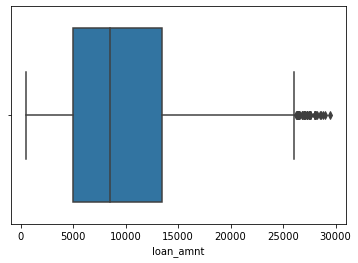

In [116]:
sns.boxplot(df.loan_amnt)
plt.show()

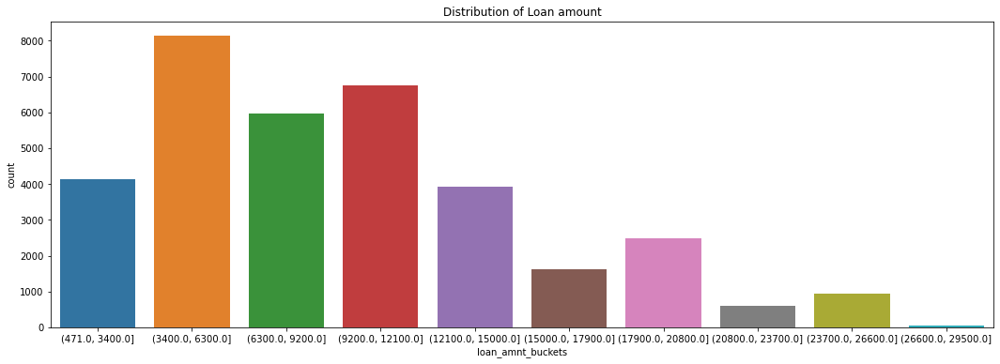

In [117]:
df['loan_amnt_buckets'] = pd.cut(df['loan_amnt'], bins=10, precision=0)
plt.figure(figsize=(18,6))
sns.countplot(x='loan_amnt_buckets', data=df)
plt.title('Distribution of Loan amount')
plt.show()

Most customers have taken a loan between 5000 to 13487, specifically in the range of 3400 to 6300 but less loans were taken as amount increases from 12100

In [118]:
#funded_amnt
df.funded_amnt.describe()

count    34639.000000
mean      9513.113831
std       5563.866837
min        500.000000
25%       5000.000000
50%       8450.000000
75%      13000.000000
max      27600.000000
Name: funded_amnt, dtype: float64

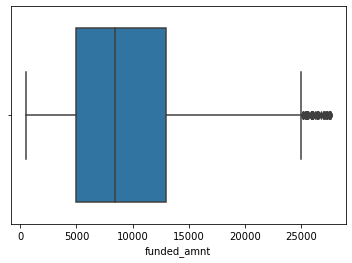

In [119]:
sns.boxplot(df.funded_amnt)
plt.show()

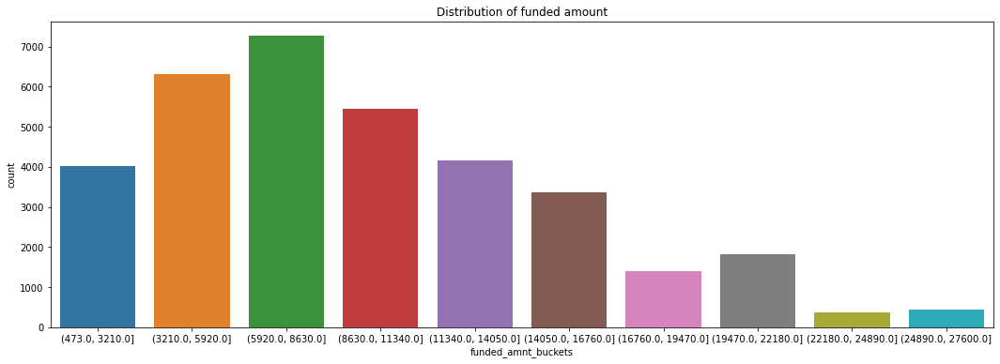

In [120]:
df['funded_amnt_buckets'] = pd.cut(df['funded_amnt'], bins=10, precision=0)
plt.figure(figsize=(18,6))
sns.countplot(x='funded_amnt_buckets', data=df)
plt.title('Distribution of funded amount')
plt.show()

Most customers have been increasingly funded for the loan between 5000 to 13000 towards the range of 5290 to 8630, whereas there can be seen a constant decrease of funded amount after 8630

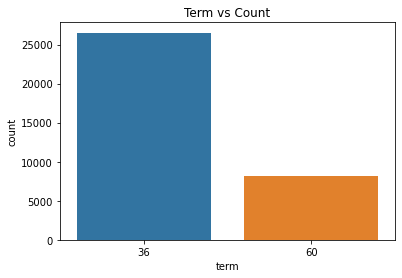

In [121]:
#term
sns.countplot(x='term', data=df)
plt.title('Term vs Count')
plt.show()

Most of the loans are taken for a term of 36, where as loans taken for term of 60 are is about 50% less than that of 36 term loan.

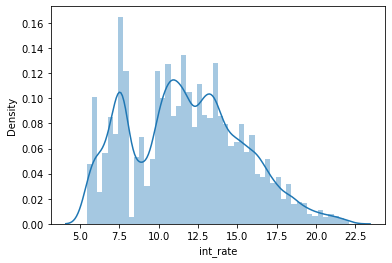

In [122]:
#int_rate
sns.distplot(df.int_rate)
plt.show()

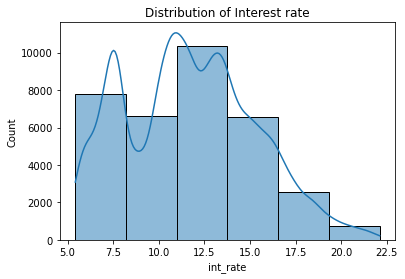

In [123]:
sns.histplot(data=df.int_rate, bins=6, kde=True)
plt.title('Distribution of Interest rate')
plt.show()

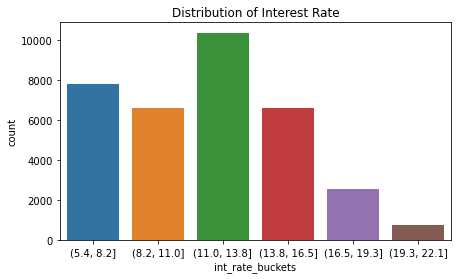

In [124]:
#Plotting the data
df['int_rate_buckets'] = pd.cut(df['int_rate'], bins=6, precision=1)
plt.figure(figsize=(7,4))
sns.countplot(x='int_rate_buckets', data=df)
plt.title('Distribution of Interest Rate')
plt.show()

count    34639.000000
mean        11.730993
std          3.582060
min          5.420000
25%          8.900000
50%         11.580000
75%         14.220000
max         22.110000
Name: int_rate, dtype: float64


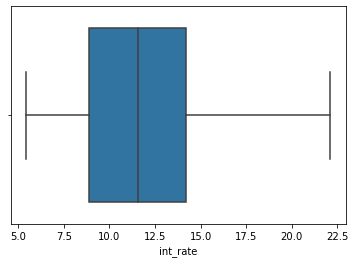

In [125]:
print(df.int_rate.describe())
sns.boxplot(df.int_rate)
plt.show()

Most customers have taken the loans with interest rate between 8.9% to 14.22%, specifically in the range of 11% to 13.8%

count    34639.000000
mean       284.366424
std        161.115108
min         15.690000
25%        158.860000
50%        258.100000
75%        383.660000
max        762.080000
Name: installment, dtype: float64


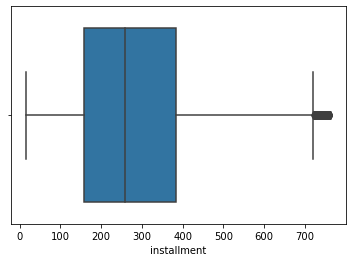

In [126]:
#installment
print(df.installment.describe())
sns.boxplot(df.installment)
plt.show()

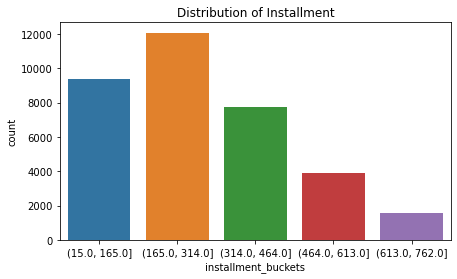

In [127]:
df['installment_buckets'] = pd.cut(df['installment'], bins=5, precision=0)
plt.figure(figsize=(7,4))
sns.countplot(x='installment_buckets', data=df)
plt.title('Distribution of Installment')
plt.show()

Installment owed by most of the customers is in the range of 158.86 to 383.66, especially between 165 to 314

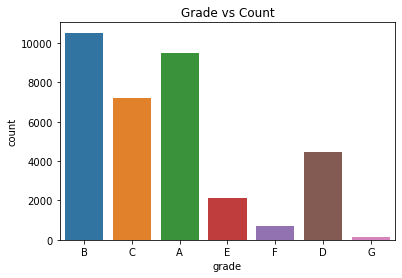

In [128]:
#grade
sns.countplot(x='grade',data=df)
plt.title('Grade vs Count')
plt.show()

Most customers were of grade 'B', followed by 'A' and 'C'

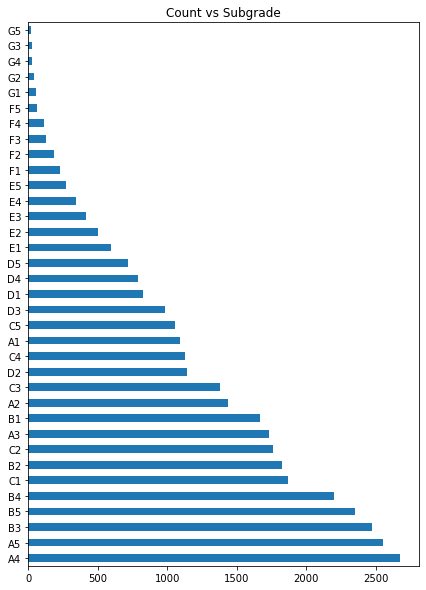

In [129]:
#sub_grade
plt.figure(figsize=(7,10))
df.sub_grade.value_counts().plot.barh()
plt.title('Count vs Subgrade')
plt.show()

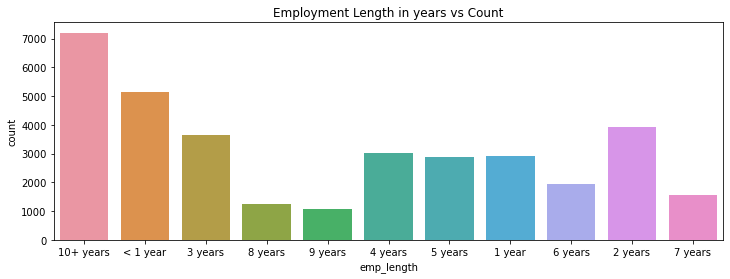

In [130]:
#emp_length
plt.figure(figsize=(12,4))
sns.countplot(x='emp_length',data=df)
plt.title('Employment Length in years vs Count')
plt.show()

Majority of borrowers applying for the loan have employment length more than 10 years

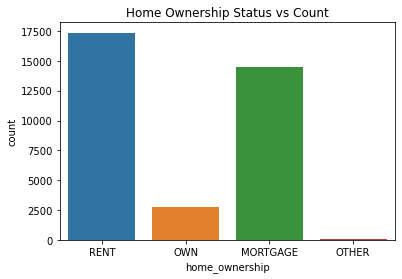

In [131]:
#home_ownership
sns.countplot(x='home_ownership',data=df)
plt.title('Home Ownership Status vs Count')
plt.show()

Majority of the borrowers have a Home Ownership Status of RENT followed by MORTGAGE

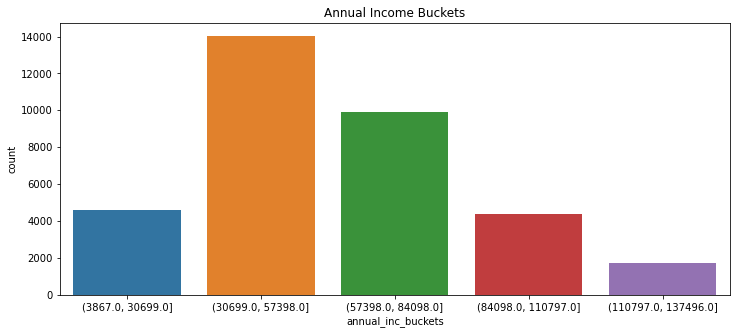

In [132]:
#annual_inc
plt.figure(figsize=(12,5))
df['annual_inc_buckets'] = pd.cut(df['annual_inc'], bins=5,precision =0)
sns.countplot(x='annual_inc_buckets',data=df)
plt.title('Annual Income Buckets')
plt.show()

Majority of the customers have a annual income in the range of 30699 to 57398.

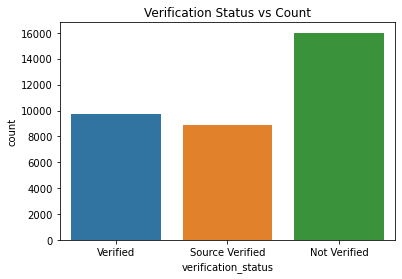

In [133]:
#verification_status
sns.countplot(x='verification_status',data=df)
plt.title('Verification Status vs Count')
plt.show()

Around 50% of the customers are granted loan with income Not verified. Among the remaining customers, around 25% of them have their income verified and the rest 25% have their income source verified

In [134]:
#issue_d
df['issue_month'] = df.issue_d.apply(lambda x: str(x.month))
df['issue_year'] = df.issue_d.apply(lambda x: str(x.year))

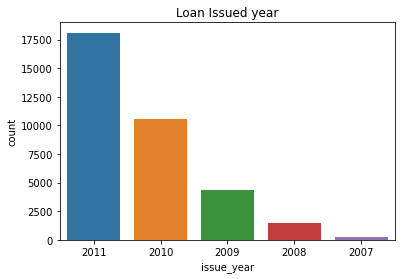

In [135]:
#issue_year
sns.countplot(x='issue_year',data=df)
plt.title('Loan Issued year')
plt.show()

Most loans were issued in the year 2011. The number of loans granted are exponentially increasing by every year

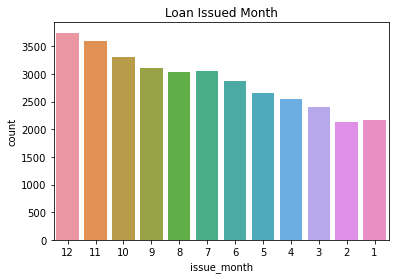

In [136]:
#issue_month
sns.countplot(x='issue_month',data=df)
plt.title('Loan Issued Month')
plt.show()

More loans are issued towards the end of the year compared to the year beginning, there is a contant increase in loan issue from January to December. The loan issuing gets stabilised in the middle of the year, around June-August.

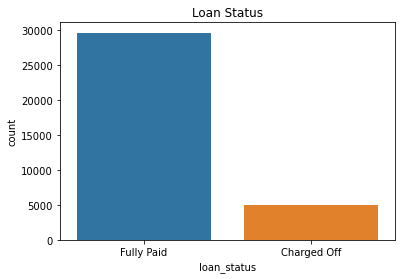

Charged off is 14.480787551603683


In [137]:
#loan_status
sns.countplot(x='loan_status',data=df)
plt.title('Loan Status')
plt.show()

Total = df.loan_status.shape[0]
c_off = df.loan_status[(df.loan_status=='Charged Off')].shape[0]
print(f'Charged off is {(c_off/Total)*100}')

The Charged off customers are about 14% of the total customers.

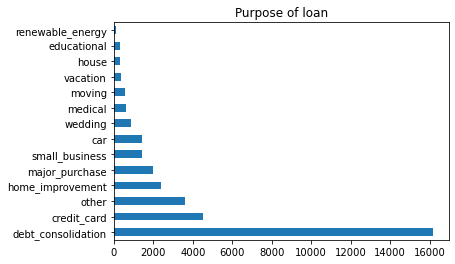

In [138]:
#purpose
df.purpose.value_counts().plot.barh()
plt.title('Purpose of loan')
plt.show()

Majority of the loans were taken with the purpose of debt Consolidation and credit card. Renewable energy, education,housing and vacation are the lowest probable reasons to attract a loan.

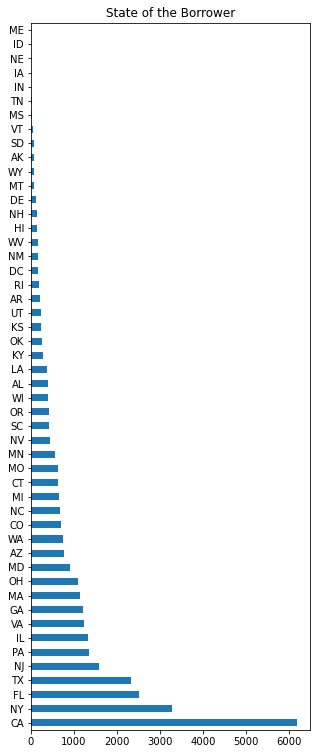

In [139]:
#addr_state
plt.figure(figsize=(5,13))
df.addr_state.value_counts().plot.barh()
plt.title('State of the Borrower')
plt.show()

Majority of the loans were taken from borrowers belonging to California state, followed by New york, Florida and Texas. Maine, Idaho, Nebraska, Iowa, Tennessee, Mississippi almost have negligible amount of borrowers.

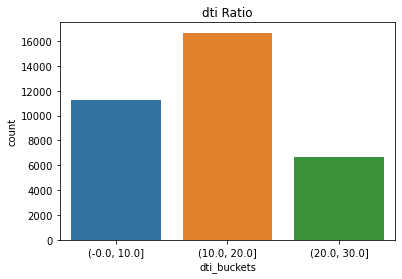

In [140]:
#dti
df['dti_buckets'] = pd.cut(df['dti'], bins=3,precision =0)
sns.countplot(x='dti_buckets',data=df)
plt.title('dti Ratio')
plt.show()

A dti ratio between 10 to 20 havs been observed among majority of the borrowers

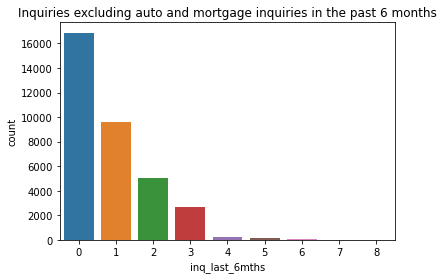

In [141]:
#inq_last_6mths
sns.countplot(x='inq_last_6mths',data=df)
plt.title('Inquiries excluding auto and mortgage inquiries in the past 6 months')
plt.show()

No inquiries excluding auto and mortgage inquiries were made majorly in the last 6 months. Although there were 1-3 inquiries made in some cases.

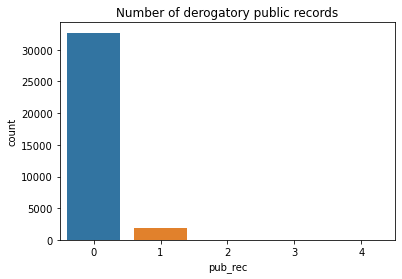

In [142]:
#pub_rec
sns.countplot(x='pub_rec',data=df)
plt.title('Number of derogatory public records')
plt.show()

Only around 6% of the borrowers have derogatory public records

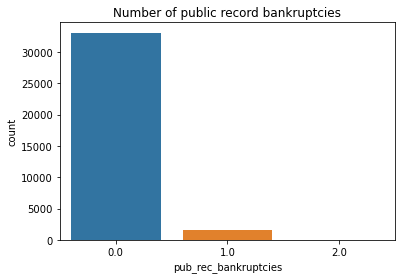

In [143]:
#pub_rec_bankruptcies
sns.countplot(x='pub_rec_bankruptcies',data=df)
plt.title('Number of public record bankruptcies')
plt.show()

Only around 5% of the borrowers have public record bankruptcies

__Observations from UniVariate Analysis:__

1. Most customers have taken a loan between 5000 to 13487, specifically in the range of 3400 to 6300 but less loans were taken as amount increases from 12100

2. Most customers have been increasingly funded for the loan between 5000 to 13000 towards the range of 5290 to 8630, whereas there can be seen a constant decrease of funded amount after 8630

3. Most of the loans are taken for a term of 36, where as loans taken for term of 60 are is about 50% less than that of 36 term loan.

4. Most customers have taken the loans with interest rate between 8.9% to 14.22%, specifically in the range of 11% to 13.8%

5. Installment owed by most of the customers is in the range of 158.86 to 383.66, especially between 165 to 314

6. Most customers were of grade 'B', followed by 'A' and 'C'

7. Majority of borrowers applying for the loan have employment length more than 10 years

8. Majority of the borrowers have a Home Ownership Status of RENT followed by MORTGAGE

9. Majority of the customers have a annual income in the range of 30699 to 57398

10. Around 50% of the customers are granted loan with income Not verified. Among the remaining customers, around 25% of them have their income verified and the rest 25% have their income source verified

11. Most loans were issued in the year 2011. The number of loans granted are exponentially increasing by every year

12. More loans are issued in months towards the end of the year compared to the year beginning, there is a contant increase in loan issue from January to December. The loan issuing gets stabilised in the middle of the year, around June-August.

13. The Charged off customers are around 14% of the total customers.

14. Majority of the loans were taken with the purpose of debt Consolidation and credit card. Renewable energy, education,housing and vacation are the lowest probable reasons to attract a loan.

15. Majority of the loans were taken from borrowers belonging to California state, followed by New york, Florida and Texas. Maine, Idaho, Nebraska, Iowa, Tennessee, Mississippi almost have negligible amount of borrowers.

16. A dti ratio between 10 to 20 has been observed among majority of the borrowers

17. No inquiries excluding auto and mortgage inquiries were made majorly in the last 6 months. Although there were 1-3 inquiries made in some cases.

18. Around 6% of the borrowers have derogatory public records

19. Around 5% of the borrowers have public record bankruptcies

To derive conclusions, we need to compare the defaulters data with full-paid customers data.

### Segmented Univariate Analysis

The aim of this case study is to identify the driving factors behind defaulters, this can be mainly achieved through Segmented Univariated Analysis.

Data related to charged-off customers post charge-off (i.e., columns such as delinq_2yrs, revol_bal, total_pymnt, total_rec_prncp, total_rec_int, last_pymnt_d, last_pymnt_amnt) are not considered as they are out of scope in this analysis. 

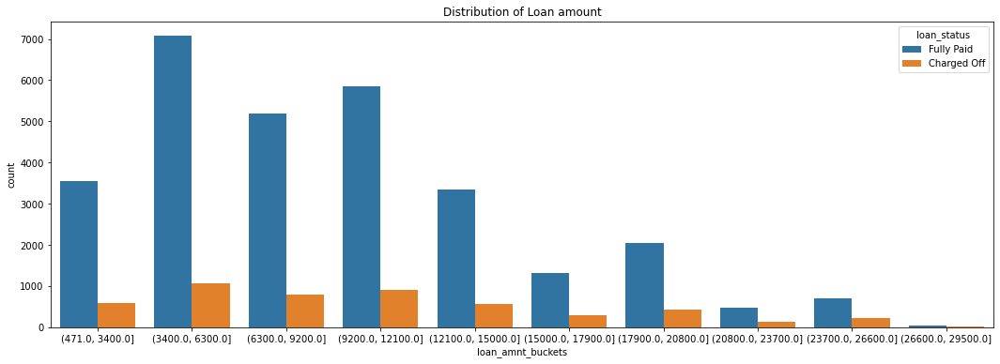

In [144]:
#loan_status vs loan_amnt
plt.figure(figsize=(18,6))
sns.countplot(x='loan_amnt_buckets',hue='loan_status', data=df)
plt.title('Distribution of Loan amount')
plt.show()

In [145]:
total_df=df['loan_amnt_buckets'].value_counts().rename_axis('buckets').reset_index(name='Totalcount')
bucket_df=df['loan_amnt_buckets'][(df.loan_status=='Charged Off')].value_counts().rename_axis('buckets').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,buckets,ChargedOffcount,TotalCount,ChargedOff%
0,"(3400.0, 6300.0]",1061,8136,13.0
1,"(9200.0, 12100.0]",899,6750,13.0
2,"(6300.0, 9200.0]",786,5980,13.0
3,"(471.0, 3400.0]",591,4138,14.0
4,"(12100.0, 15000.0]",568,3925,14.0
5,"(17900.0, 20800.0]",431,2477,17.0
6,"(15000.0, 17900.0]",304,1624,19.0
7,"(23700.0, 26600.0]",233,941,25.0
8,"(20800.0, 23700.0]",127,612,21.0
9,"(26600.0, 29500.0]",16,56,29.0


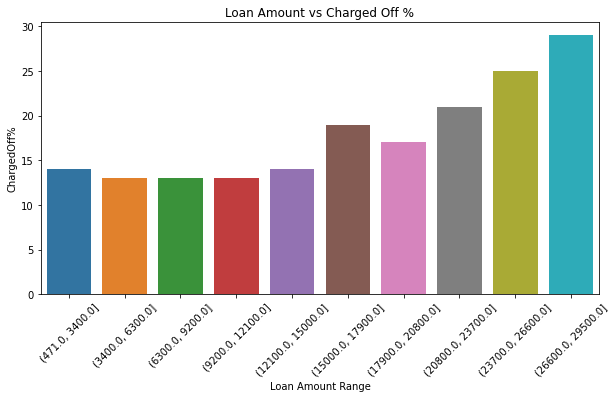

In [146]:
#To visualise the chances of charge off 
plt.figure(figsize=(10,5))
sns.barplot(x='buckets', y='ChargedOff%', data=bucket_df)
plt.xticks(rotation=45)
plt.xlabel('Loan Amount Range')
plt.title('Loan Amount vs Charged Off %')
plt.show()

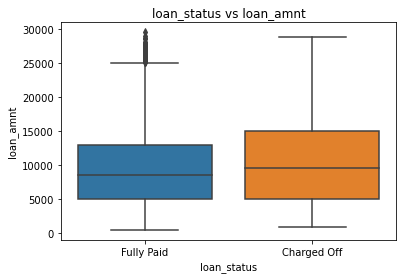

In [147]:
sns.boxplot(x=df.loan_status, y=df.loan_amnt)
plt.title('loan_status vs loan_amnt')
plt.show()

In [148]:
df['loan_amnt'][(df.loan_status=='Charged Off')].describe()

count     5016.000000
mean     10501.191188
std       6355.915706
min        900.000000
25%       5000.000000
50%       9600.000000
75%      15000.000000
max      28800.000000
Name: loan_amnt, dtype: float64


Observation:

1. There is a 29% chance that a loan can be charged off for the loan amount applied between 26600 and 29500.

2. Most number of ChargedOff loans are applied for amounts between 5000 and 15000.

3. Even though less number of loans are taken in the range 20800 to 29500, On an average there is more than 23% chance that a loan can be charged off among the loans applied for this amount.

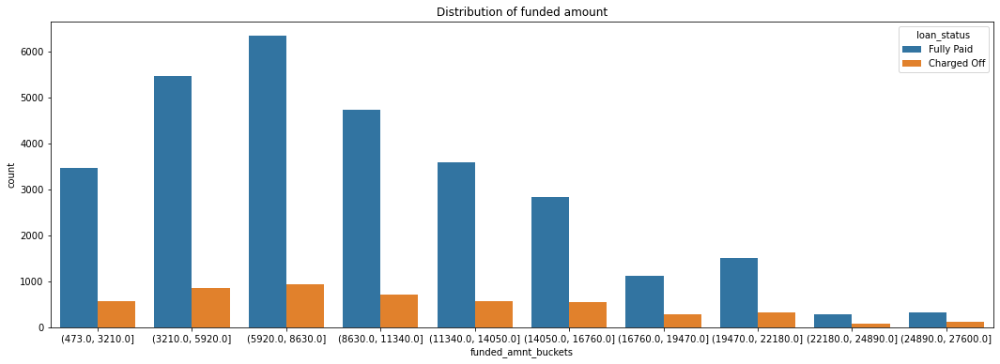

In [149]:
#loan_status vs funded_amnt
plt.figure(figsize=(18,6))
sns.countplot(x='funded_amnt_buckets',hue='loan_status', data=df)
plt.title('Distribution of funded amount')
plt.show()

In [150]:
total_df=df['funded_amnt_buckets'].value_counts().rename_axis('buckets').reset_index(name='Totalcount')
bucket_df=df['funded_amnt_buckets'][(df.loan_status=='Charged Off')].value_counts().rename_axis('buckets').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,buckets,ChargedOffcount,TotalCount,ChargedOff%
0,"(5920.0, 8630.0]",935,7266,13.0
1,"(3210.0, 5920.0]",863,6321,14.0
2,"(8630.0, 11340.0]",708,5436,13.0
3,"(11340.0, 14050.0]",577,4171,14.0
4,"(473.0, 3210.0]",573,4028,14.0
5,"(14050.0, 16760.0]",553,3376,16.0
6,"(19470.0, 22180.0]",318,1816,18.0
7,"(16760.0, 19470.0]",286,1404,20.0
8,"(24890.0, 27600.0]",122,451,27.0
9,"(22180.0, 24890.0]",81,370,22.0


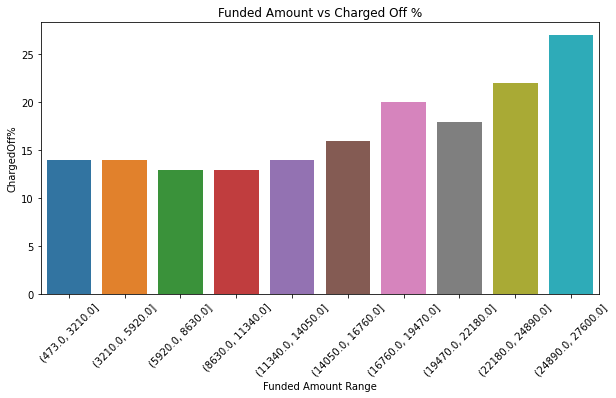

In [151]:
#To visualise the chances of charge off 
plt.figure(figsize=(10,5))
sns.barplot(x='buckets', y='ChargedOff%', data=bucket_df)
plt.xticks(rotation=45)
plt.xlabel('Funded Amount Range')
plt.title('Funded Amount vs Charged Off %')
plt.show()

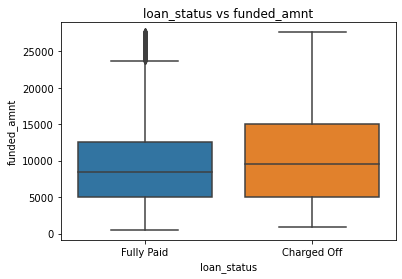

In [152]:
sns.boxplot(x=df.loan_status, y=df.funded_amnt)
plt.title('loan_status vs funded_amnt')
plt.show()

In [153]:
df['funded_amnt'][(df.loan_status=='Charged Off')].describe()

count     5016.000000
mean     10222.159091
std       6073.431460
min        900.000000
25%       5000.000000
50%       9500.000000
75%      15000.000000
max      27600.000000
Name: funded_amnt, dtype: float64


Observation:

1. There is a 27% chance of charge off if the funded amount is in the range 24890 to 27600
2. Most number of chargd off loans are funded between the range 900 to 15000.
3. Although less number of loans are taken, there is a greater chance of charge off for amounts above 16760

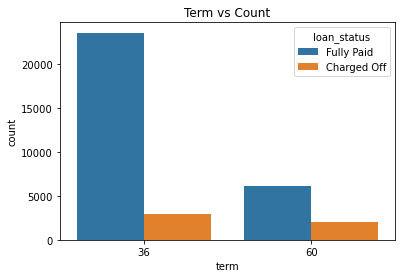

In [154]:
#loan_status vs term
sns.countplot(x='term', hue='loan_status', data=df)
plt.title('Term vs Count')
plt.show()

In [155]:
total_df=df['term'].value_counts().rename_axis('terms').reset_index(name='Totalcount')
bucket_df=df['term'][(df.loan_status=='Charged Off')].value_counts().rename_axis('terms').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,terms,ChargedOffcount,TotalCount,ChargedOff%
0,36,2955,26513,11.0
1,60,2061,8126,25.0


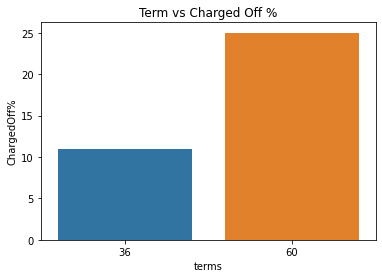

In [156]:
#To visualise the chances of charge off 
sns.barplot(x='terms', y='ChargedOff%', data=bucket_df)
plt.title('Term vs Charged Off %')
plt.show()

Observation:
    
There is a 25% chance that a loan can be charged off for a term of 60 months whereas there is a 11% chance of charge off for a 36 month term.

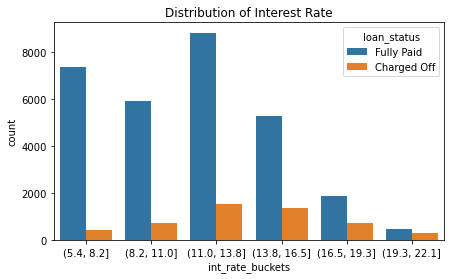

In [157]:
#loan_status vs int_rate
plt.figure(figsize=(7,4))
sns.countplot(x='int_rate_buckets',hue='loan_status', data=df)
plt.title('Distribution of Interest Rate')
plt.show()

In [158]:
total_df=df['int_rate_buckets'].value_counts().rename_axis('buckets').reset_index(name='Totalcount')
bucket_df=df['int_rate_buckets'][(df.loan_status=='Charged Off')].value_counts().rename_axis('buckets').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,buckets,ChargedOffcount,TotalCount,ChargedOff%
0,"(11.0, 13.8]",1544,10352,15.0
1,"(13.8, 16.5]",1336,7799,17.0
2,"(16.5, 19.3]",718,6614,11.0
3,"(8.2, 11.0]",708,6585,11.0
4,"(5.4, 8.2]",430,2566,17.0
5,"(19.3, 22.1]",280,723,39.0


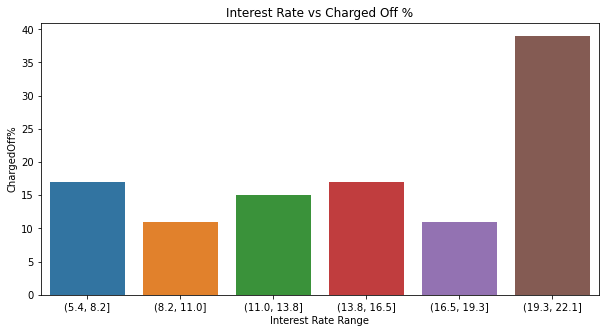

In [159]:
#To visualise the chances of charge off 
plt.figure(figsize=(10,5))
sns.barplot(x='buckets', y='ChargedOff%', data=bucket_df)
plt.xlabel('Interest Rate Range')
plt.title('Interest Rate vs Charged Off %')
plt.show()

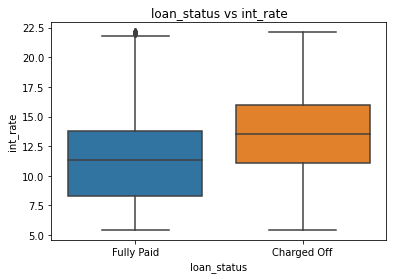

In [160]:
sns.boxplot(x=df.loan_status, y=df.int_rate)
plt.title('loan_status vs int_rate')
plt.show()

In [161]:
df['int_rate'][(df.loan_status=='Charged Off')].describe()

count    5016.000000
mean       13.536669
std         3.520257
min         5.420000
25%        11.110000
50%        13.490000
75%        16.000000
max        22.110000
Name: int_rate, dtype: float64

Observation:

1. Most number of charged off loans are taken at a interest rate between 11.11 and 16.00
2. There is a 39% chance of charge off if the interest rate is between 19.3 and 22.1
3. Although less number of loans are taken at a interest rate above 19.3, there is a greater chance of charge off in this case.
4. Median of interest rate in Charged off loans is 13.5% which is way above than that of interest in fully paid loans(11%)

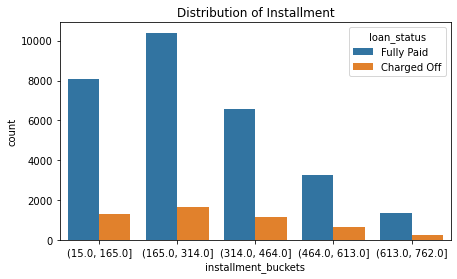

In [162]:
#loan_status vs installment
plt.figure(figsize=(7,4))
sns.countplot(x='installment_buckets', hue='loan_status', data=df)
plt.title('Distribution of Installment')
plt.show()

In [163]:
total_df=df['installment_buckets'].value_counts().rename_axis('buckets').reset_index(name='Totalcount')
bucket_df=df['installment_buckets'][(df.loan_status=='Charged Off')].value_counts().rename_axis('buckets').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,buckets,ChargedOffcount,TotalCount,ChargedOff%
0,"(165.0, 314.0]",1663,12062,14.0
1,"(15.0, 165.0]",1312,9380,14.0
2,"(314.0, 464.0]",1162,7746,15.0
3,"(464.0, 613.0]",642,3879,17.0
4,"(613.0, 762.0]",237,1572,15.0


Observation:
There is no clear distinction of charge off between any of the buckets with respect to installment.

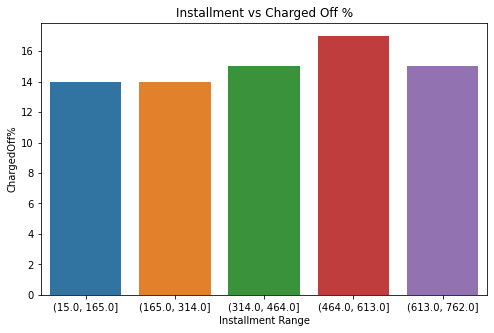

In [164]:
#To visualise the chances of charge off 
plt.figure(figsize=(8,5))
sns.barplot(x='buckets', y='ChargedOff%', data=bucket_df)
plt.xlabel('Installment Range')
plt.title('Installment vs Charged Off %')
plt.show()

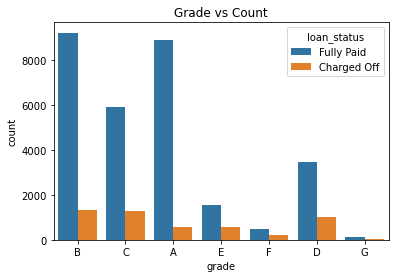

In [165]:
#loan_status vs grade
sns.countplot(x='grade',hue='loan_status',data=df)
plt.title('Grade vs Count')
plt.show()

In [166]:
total_df=df['grade'].value_counts().rename_axis('grades').reset_index(name='Totalcount')
bucket_df=df['grade'][(df.loan_status=='Charged Off')].value_counts().rename_axis('grades').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,grades,ChargedOffcount,TotalCount,ChargedOff%
0,B,1311,10518,12.0
1,C,1264,9485,13.0
2,D,998,7181,14.0
3,A,586,4454,13.0
4,E,575,2120,27.0
5,F,226,722,31.0
6,G,56,159,35.0


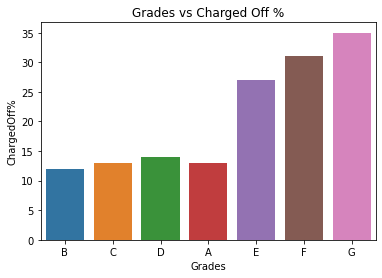

In [167]:
#To visualise the chances of charge off 
sns.barplot(x='grades', y='ChargedOff%', data=bucket_df)
plt.xlabel('Grades')
plt.title('Grades vs Charged Off %')
plt.show()

Observation:

1. A borrower with a grade G has the highest chance to go default.
2. The risk can be inferred according to the grade as G>F>E>D>(C=A)>B, Borrower with grade 'G' having the highest chance to go default and borrower of grade 'B' with relatively lower chances.

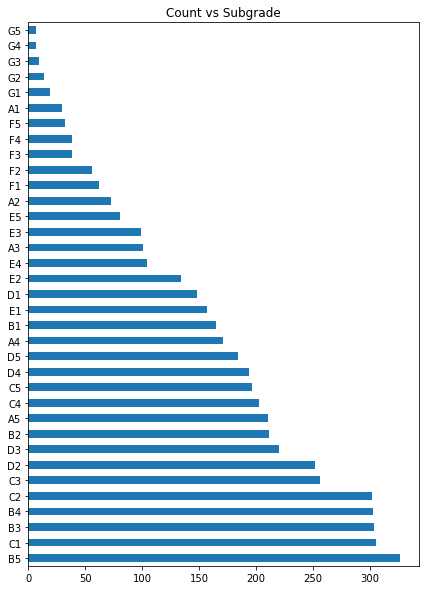

In [168]:
#loan_status vs sub_grade
plt.figure(figsize=(7,10))
df[(df.loan_status=='Charged Off')].sub_grade.value_counts().plot.barh()
plt.title('Count vs Subgrade')
plt.show()

In [169]:
total_df=df['sub_grade'].value_counts().rename_axis('sub_grades').reset_index(name='Totalcount')
bucket_df=df['sub_grade'][(df.loan_status=='Charged Off')].value_counts().rename_axis('sub_grades').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df['Grade'] = bucket_df['sub_grades'].apply(lambda x: x[0])

In [170]:
#Check for Grade A
bucket_df[(bucket_df['Grade']=='A')]

,sub_grades,ChargedOffcount,TotalCount,ChargedOff%,Grade
9,A5,211,1666,13.0,A
14,A4,171,1093,16.0,A
20,A3,101,593,17.0,A
23,A2,73,340,21.0,A
29,A1,30,66,45.0,A


In [171]:
#Check for Grade B
bucket_df[(bucket_df['Grade']=='B')]

,sub_grades,ChargedOffcount,TotalCount,ChargedOff%,Grade
0,B5,327,2676,12.0,B
2,B3,304,2475,12.0,B
3,B4,303,2351,13.0,B
8,B2,212,1730,12.0,B
15,B1,165,1053,16.0,B


In [172]:
#Check for Grade C
bucket_df[(bucket_df['Grade']=='C')]

,sub_grades,ChargedOffcount,TotalCount,ChargedOff%,Grade
1,C1,306,2553,12.0,C
4,C2,302,2200,14.0,C
5,C3,256,1865,14.0,C
10,C4,203,1433,14.0,C
11,C5,197,1376,14.0,C


In [173]:
#Check for Grade D
bucket_df[(bucket_df['Grade']=='D')]

,sub_grades,ChargedOffcount,TotalCount,ChargedOff%,Grade
6,D2,252,1826,14.0,D
7,D3,220,1762,12.0,D
12,D4,194,1144,17.0,D
13,D5,184,1125,16.0,D
17,D1,148,827,18.0,D


In [174]:
#Check for Grade E
bucket_df[(bucket_df['Grade']=='E')]

,sub_grades,ChargedOffcount,TotalCount,ChargedOff%,Grade
16,E1,157,982,16.0,E
18,E2,134,787,17.0,E
19,E4,104,714,15.0,E
21,E3,99,501,20.0,E
22,E5,81,414,20.0,E


In [175]:
#Check for Grade F
bucket_df[(bucket_df['Grade']=='F')]

,sub_grades,ChargedOffcount,TotalCount,ChargedOff%,Grade
24,F1,62,272,23.0,F
25,F2,56,230,24.0,F
26,F3,38,183,21.0,F
27,F4,38,127,30.0,F
28,F5,32,116,28.0,F


In [176]:
#Check for Grade G
bucket_df[(bucket_df['Grade']=='G')]

,sub_grades,ChargedOffcount,TotalCount,ChargedOff%,Grade
30,G1,19,55,35.0,G
31,G2,14,40,35.0,G
32,G3,9,25,36.0,G
33,G4,7,23,30.0,G
34,G5,7,16,44.0,G


Observations:
1. Borrower with A1 subgrade has the highest chance(45%) to be charged off among Grade A
2. Borrower with B1 subgrade has a bit higher chance(16%) to be charged off among Grade B
3. Borrower with C1 subgrade has the lowest chance(12%) to be charged off among Grade C
4. Borrower with D4 subgrade has a bit higher chance(17%) to be charged off among Grade D
5. Borrower with E3 and E5 subgrades have a higher chance(20%) to be charged off among Grade E
6. Borrower with F4 subgrade has a bit higher chance(17%) to be charged off among Grade F
7. Borrower with G5 subgrade has the highest chance(44%) to be charged off among Grade G

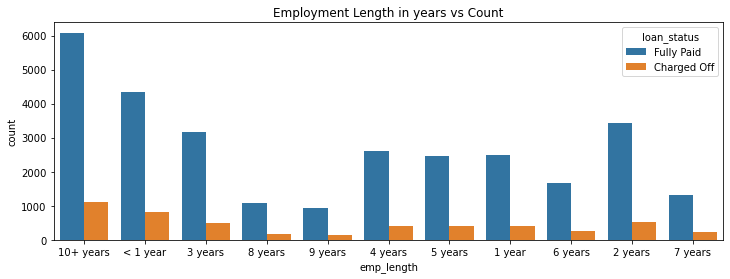

In [177]:
#loan_status vs emp_length
plt.figure(figsize=(12,4))
sns.countplot(x='emp_length',hue='loan_status',data=df)
plt.title('Employment Length in years vs Count')
plt.show()

In [178]:
total_df=df['emp_length'].value_counts().rename_axis('length').reset_index(name='Totalcount')
bucket_df=df['emp_length'][(df.loan_status=='Charged Off')].value_counts().rename_axis('length').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,length,ChargedOffcount,TotalCount,ChargedOff%
0,10+ years,1123,7204,16.0
1,< 1 year,805,5159,16.0
2,2 years,517,3938,13.0
3,3 years,496,3655,14.0
4,1 year,419,3034,14.0
5,5 years,412,2918,14.0
6,4 years,411,2883,14.0
7,6 years,275,1958,14.0
8,7 years,238,1548,15.0
9,8 years,178,1253,14.0


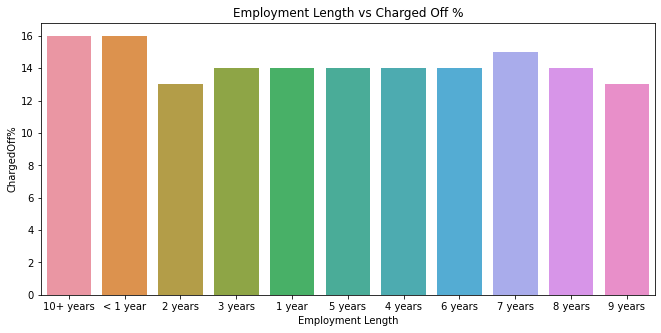

In [179]:
#To visualise the chances of charge off 
plt.figure(figsize=(11,5))
sns.barplot(x='length', y='ChargedOff%', data=bucket_df)

plt.xlabel('Employment Length')
plt.title('Employment Length vs Charged Off %')
plt.show()

Observation:
Borrowers with employment length either above 10 years or <1 year have the highest chance to be charged off.

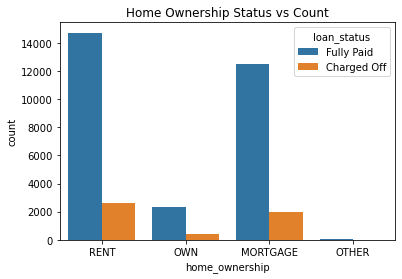

In [180]:
#loan_status vs home_ownership
sns.countplot(x='home_ownership',hue='loan_status',data=df)
plt.title('Home Ownership Status vs Count')
plt.show()

In [181]:
total_df=df['home_ownership'].value_counts().rename_axis('Ownership').reset_index(name='Totalcount')
bucket_df=df['home_ownership'][(df.loan_status=='Charged Off')].value_counts().rename_axis('Ownership').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,Ownership,ChargedOffcount,TotalCount,ChargedOff%
0,RENT,2637,17354,15.0
1,MORTGAGE,1957,14469,14.0
2,OWN,406,2724,15.0
3,OTHER,16,92,17.0


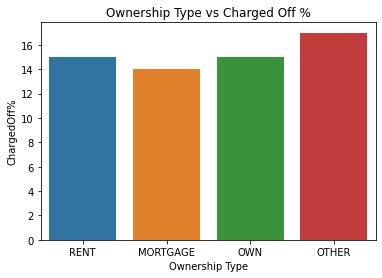

In [182]:
#To visualise the chances of charge off 
sns.barplot(x='Ownership', y='ChargedOff%', data=bucket_df)

plt.xlabel('Ownership Type')
plt.title('Ownership Type vs Charged Off %')
plt.show()

Borrower with Home ownership type 'OTHER' has the highest chance to be charged off.

There is no clear distinction amongst other ownership types.

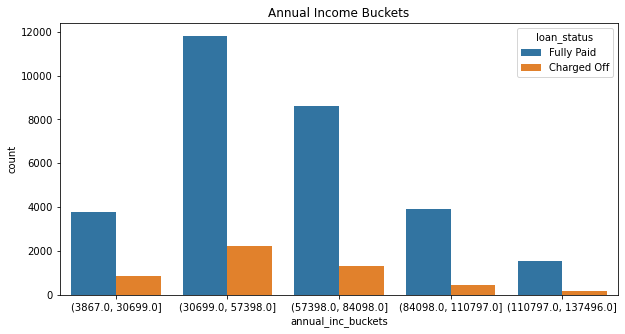

In [183]:
#loan_status vs annual_inc
plt.figure(figsize=(10,5))
sns.countplot(x='annual_inc_buckets',hue='loan_status',data=df)
plt.title('Annual Income Buckets')
plt.show()

In [184]:
total_df=df['annual_inc_buckets'].value_counts().rename_axis('buckets').reset_index(name='Totalcount')
bucket_df=df['annual_inc_buckets'][(df.loan_status=='Charged Off')].value_counts().rename_axis('buckets').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,buckets,ChargedOffcount,TotalCount,ChargedOff%
0,"(30699.0, 57398.0]",2227,14028,16.0
1,"(57398.0, 84098.0]",1318,9932,13.0
2,"(3867.0, 30699.0]",856,4615,19.0
3,"(84098.0, 110797.0]",455,4360,10.0
4,"(110797.0, 137496.0]",160,1704,9.0


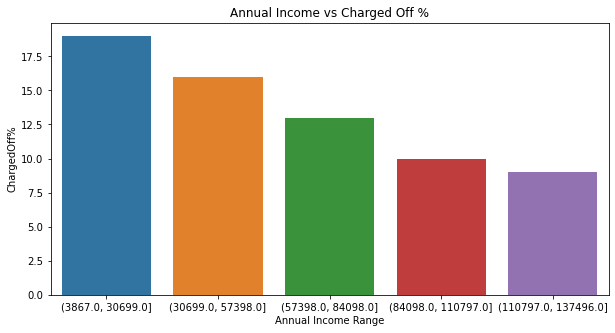

In [185]:
#To visualise the chances of charge off 
plt.figure(figsize=(10,5))
sns.barplot(x='buckets', y='ChargedOff%', data=bucket_df)

plt.xlabel('Annual Income Range')
plt.title('Annual Income vs Charged Off %')
plt.show()

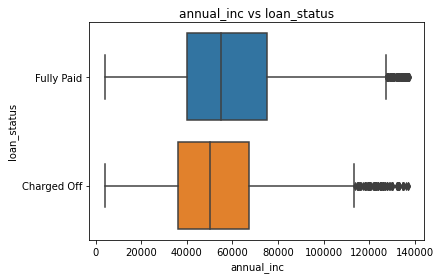

In [186]:
sns.boxplot(x=df.annual_inc, y=df.loan_status)
plt.title('annual_inc vs loan_status')
plt.show()

In [187]:
df['annual_inc'][(df.loan_status=='Charged Off')].describe()

count      5016.000000
mean      53830.501896
std       24813.862273
min        4080.000000
25%       36000.000000
50%       50000.000000
75%       67074.000000
max      137004.000000
Name: annual_inc, dtype: float64

Observations:
1. Most number of charged off loans are applied by the borrowers with annual income between 36000 and 67074
2. There is a high chance of charge off if the borrower's income is below 30699
3. There is a low chance of charge off if the borrowers income is above 84100
4. The median of charged off borrower's income falls in the range 30699 and 57398, which has a bit higher chance of charge off.

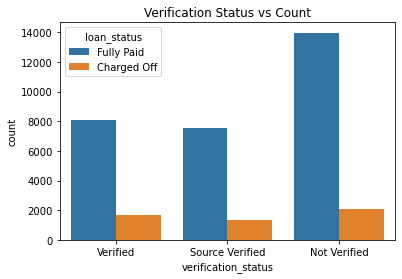

In [188]:
#loan_status vs verification_status
sns.countplot(x='verification_status',hue='loan_status',data=df)
plt.title('Verification Status vs Count')
plt.show()

In [189]:
total_df=df['verification_status'].value_counts().rename_axis('status').reset_index(name='Totalcount')
bucket_df=df['verification_status'][(df.loan_status=='Charged Off')].value_counts().rename_axis('status').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,status,ChargedOffcount,TotalCount,ChargedOff%
0,Not Verified,2049,16005,13.0
1,Verified,1648,9741,17.0
2,Source Verified,1319,8893,15.0


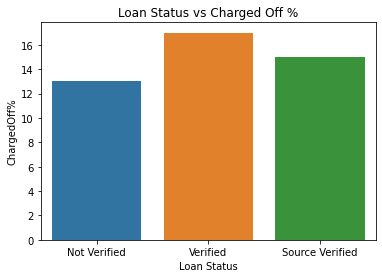

In [190]:
#To visualise the chances of charge off 
sns.barplot(x='status', y='ChargedOff%', data=bucket_df)
plt.xlabel('Loan Status')
plt.title('Loan Status vs Charged Off %')
plt.show()

Observation:
Though the number of loans that are charged off does not have their Income verified, there is a greater chance of charge off(17%) even when the Income source of the borrower is verified.



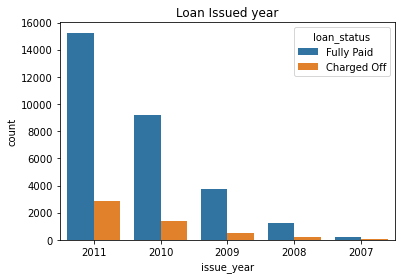

In [191]:
#loan_status vs issue_year
sns.countplot(x='issue_year',hue='loan_status',data=df)
plt.title('Loan Issued year')
plt.show()

In [192]:
total_df=df['issue_year'].value_counts().rename_axis('year').reset_index(name='Totalcount')
bucket_df=df['issue_year'][(df.loan_status=='Charged Off')].value_counts().rename_axis('year').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,year,ChargedOffcount,TotalCount,ChargedOff%
0,2011,2847,18090,16.0
1,2010,1378,10570,13.0
2,2009,536,4318,12.0
3,2008,220,1445,15.0
4,2007,35,216,16.0


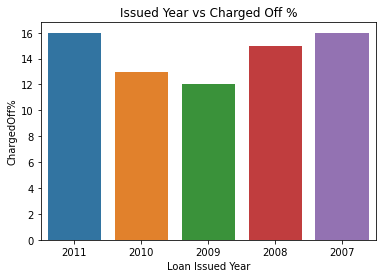

In [193]:
#To visualise the chances of charge off 
sns.barplot(x='year', y='ChargedOff%', data=bucket_df)
plt.xlabel('Loan Issued Year')
plt.title('Issued Year vs Charged Off %')
plt.show()

Observation:
1. The Number of charged-off loans keeps increasing each year as the number of loans issued also increased.
2. But there were more of loans that were charged off in 2007 and 2008 as well, along with 2011.
3. There were relatively lesser charged off loans issued in the years 2009 and 2010.

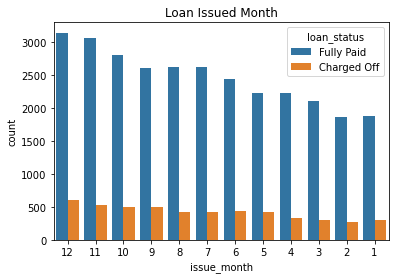

In [194]:
#loan_status vs issue_month
sns.countplot(x='issue_month',hue='loan_status',data=df)
plt.title('Loan Issued Month')
plt.show()

In [195]:
total_df=df['issue_month'].value_counts().rename_axis('Month').reset_index(name='Totalcount')
bucket_df=df['issue_month'][(df.loan_status=='Charged Off')].value_counts().rename_axis('Month').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,Month,ChargedOffcount,TotalCount,ChargedOff%
0,12,601,3747,16.0
1,11,526,3598,15.0
2,9,500,3304,15.0
3,10,494,3106,16.0
4,6,432,3048,14.0
5,7,429,3040,14.0
6,8,420,2872,15.0
7,5,418,2652,16.0
8,4,331,2557,13.0
9,3,304,2408,13.0


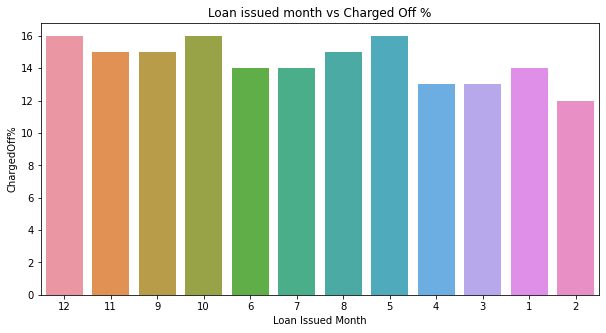

In [196]:
#To visualise the chances of charge off 
plt.figure(figsize=(10,5))
sns.barplot(x='Month', y='ChargedOff%', data=bucket_df)
plt.xlabel('Loan Issued Month')
plt.title('Loan issued month vs Charged Off %')
plt.show()

Observation:
1. Highest loan defaults occured for the loans issued in the months of May, October and December.
2. More density of charged off loans can be observed in the last quarter of the year.
3. Lowest loan defaults are recorded for the loans issued in the month of February.

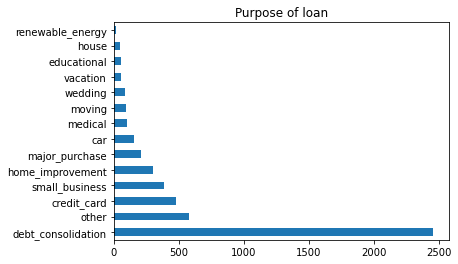

In [197]:
#loan_status vs purpose
df[(df.loan_status=='Charged Off')].purpose.value_counts().plot.barh()
plt.title('Purpose of loan')
plt.show()

In [198]:
total_df=df['purpose'].value_counts().rename_axis('purpose').reset_index(name='Totalcount')
bucket_df=df['purpose'][(df.loan_status=='Charged Off')].value_counts().rename_axis('purpose').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,purpose,ChargedOffcount,TotalCount,ChargedOff%
0,debt_consolidation,2456,16156,15.0
1,other,580,4520,13.0
2,credit_card,481,3599,13.0
3,small_business,387,2402,16.0
4,home_improvement,298,1987,15.0
5,major_purchase,208,1436,14.0
6,car,158,1434,11.0
7,medical,101,865,12.0
8,moving,90,634,14.0
9,wedding,87,536,16.0


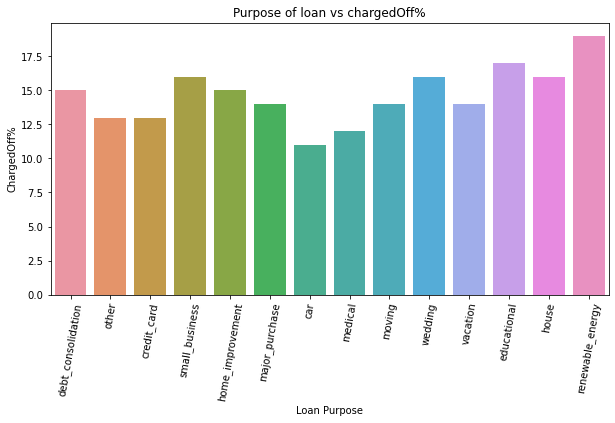

In [199]:
#To visualise the chances of charge off 
plt.figure(figsize=(10,5))
sns.barplot(x='purpose', y='ChargedOff%', data=bucket_df)
plt.xticks(rotation=80)
plt.xlabel('Loan Purpose')
plt.title('Purpose of loan vs chargedOff%')
plt.show()

Observations:
1. Majority of the loans taken for the purpose of 'Renewable Energy' are charged off.
2. The lowest chance of defaulters were having the loan with 'car' or 'medical' purpose.

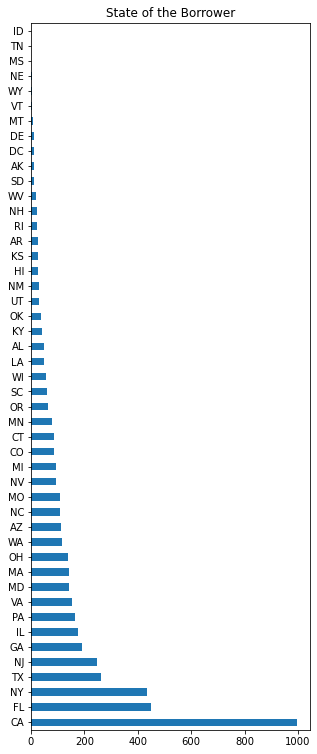

In [200]:
#loan_status vs addr_state
plt.figure(figsize=(5,13))
df[(df.loan_status=='Charged Off')].addr_state.value_counts().plot.barh()
plt.title('State of the Borrower')
plt.show()

In [201]:
total_df=df['addr_state'].value_counts().rename_axis('state').reset_index(name='Totalcount')
bucket_df=df['addr_state'][(df.loan_status=='Charged Off')].value_counts().rename_axis('state').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,state,ChargedOffcount,TotalCount,ChargedOff%
0,CA,995,6181,16.0
1,FL,448,3283,14.0
2,NY,435,2524,17.0
3,TX,264,2322,11.0
4,NJ,249,1573,16.0
5,GA,193,1357,14.0
6,IL,178,1324,13.0
7,PA,164,1230,13.0
8,VA,154,1213,13.0
9,MD,142,1150,12.0


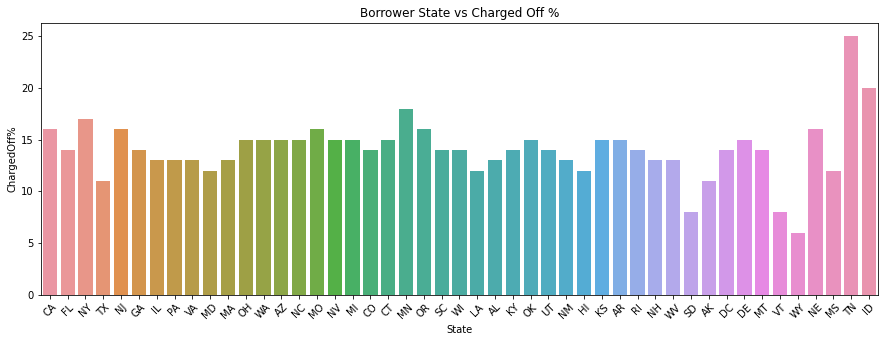

In [202]:
#To visualise the chances of charge off 
plt.figure(figsize=(15,5))
sns.barplot(x='state', y='ChargedOff%', data=bucket_df)
plt.xticks(rotation=45)
plt.xlabel('State')
plt.title('Borrower State vs Charged Off %')
plt.show()

Observation:
1. Tennessee is the state with Highest possible chance for a loan defaulter.
2. Idaho, Minnesota are also the states with a bit more chance for defaulters.
3. Though California has more records of defaulters, the chance for loan defaults is above the average.

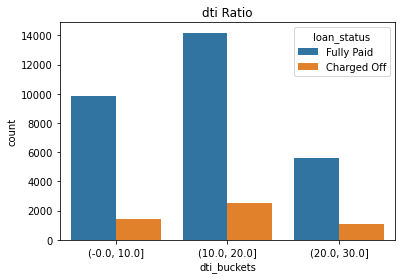

In [203]:
#loan_status vs dti
sns.countplot(x='dti_buckets',hue='loan_status',data=df)
plt.title('dti Ratio')
plt.show()

In [204]:
total_df=df['dti_buckets'].value_counts().rename_axis('buckets').reset_index(name='Totalcount')
bucket_df=df['dti_buckets'][(df.loan_status=='Charged Off')].value_counts().rename_axis('buckets').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,buckets,ChargedOffcount,TotalCount,ChargedOff%
0,"(10.0, 20.0]",2491,16665,15.0
1,"(-0.0, 10.0]",1411,11280,13.0
2,"(20.0, 30.0]",1114,6694,17.0


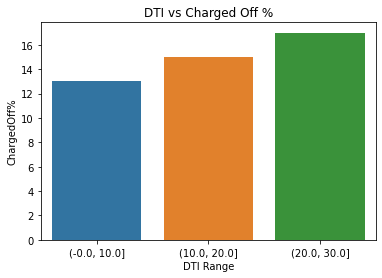

In [205]:
#To visualise the chances of charge off 
sns.barplot(x='buckets', y='ChargedOff%', data=bucket_df)
plt.xlabel('DTI Range')
plt.title('DTI vs Charged Off %')
plt.show()

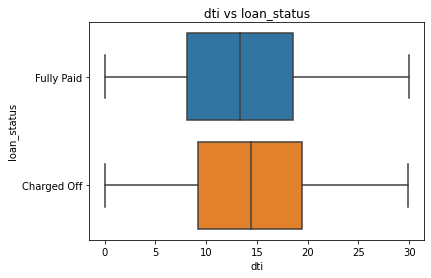

In [206]:
sns.boxplot(x=df.dti, y=df.loan_status)
plt.title('dti vs loan_status')
plt.show()

In [207]:
df['dti'][(df.loan_status=='Charged Off')].describe()

count    5016.000000
mean       14.105397
std         6.595796
min         0.000000
25%         9.200000
50%        14.400000
75%        19.462500
max        29.850000
Name: dti, dtype: float64

Observations:
1. Though there are more charged off loans for a dti ratio between 0 to 10 compared to the ratio of 20 to 30, but the chance of the borrower being default is lesser relatively.
2. dti ratio greater than 20 attracts more chance of being default
3. The median lies in between dti ratio of 10 to 20 and has a 15% chance of being charged off

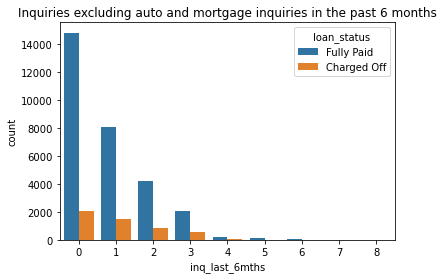

In [208]:
#loan_status vs inq_last_6mths
sns.countplot(x='inq_last_6mths',hue='loan_status',data=df)
plt.title('Inquiries excluding auto and mortgage inquiries in the past 6 months')
plt.show()

In [209]:
total_df=df['inq_last_6mths'].value_counts().rename_axis('inquiries').reset_index(name='Totalcount')
bucket_df=df['inq_last_6mths'][(df.loan_status=='Charged Off')].value_counts().rename_axis('inquiries').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,inquiries,ChargedOffcount,TotalCount,ChargedOff%
0,0,2045,16868,12.0
1,1,1487,9591,16.0
2,2,847,5058,17.0
3,3,548,2651,21.0
4,4,43,262,16.0
5,5,21,124,17.0
6,6,13,46,28.0
7,7,9,29,31.0
8,8,3,10,30.0


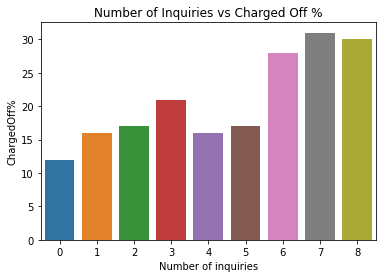

In [210]:
#To visualise the chances of charge off 
sns.barplot(x='inquiries', y='ChargedOff%', data=bucket_df)
plt.xlabel('Number of inquiries')
plt.title('Number of Inquiries vs Charged Off %')
plt.show()

Observation:
1. As the number of inquiries increases, the chance of charge off also increases, except for 4-5 inquiries, where there was a small dip.
2. If the inquiry requests made in the last 6 months are greater than 6, such loans of borrowers have near to 30% chance of being charged off.

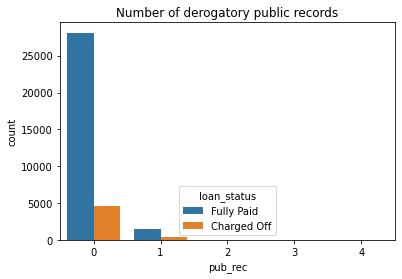

In [211]:
#loan_status vs pub_rec
sns.countplot(x='pub_rec',hue='loan_status',data=df)
plt.title('Number of derogatory public records')
plt.show()

In [212]:
total_df=df['pub_rec'].value_counts().rename_axis('records').reset_index(name='Totalcount')
bucket_df=df['pub_rec'][(df.loan_status=='Charged Off')].value_counts().rename_axis('records').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,records,ChargedOffcount,TotalCount,ChargedOff%
0,0,4581,32682,14.0
1,1,425,1903,22.0
2,2,10,46,22.0


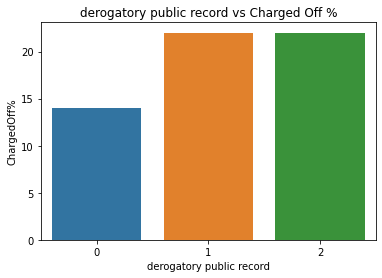

In [213]:
#To visualise the chances of charge off 
sns.barplot(x='records', y='ChargedOff%', data=bucket_df)
plt.xlabel('derogatory public record')
plt.title('derogatory public record vs Charged Off %')
plt.show()

Observation:
Borrowers with atleast one derogatory public record have a 22% chance of defaulting.
Whereas the chance of a borrower with no derogatory public records is 14%

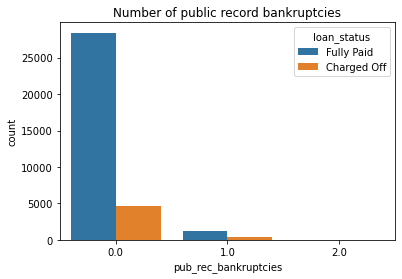

In [214]:
#loan_status vs pub_rec_bankruptcies
sns.countplot(x='pub_rec_bankruptcies',hue='loan_status',data=df)
plt.title('Number of public record bankruptcies')
plt.show()

In [215]:
total_df=df['pub_rec_bankruptcies'].value_counts().rename_axis('records').reset_index(name='Totalcount')
bucket_df=df['pub_rec_bankruptcies'][(df.loan_status=='Charged Off')].value_counts().rename_axis('records').reset_index(name='ChargedOffcount')
bucket_df["TotalCount"] = total_df['Totalcount']
bucket_df["ChargedOff%"] = round(bucket_df['ChargedOffcount']/bucket_df['TotalCount']*100)
bucket_df

,records,ChargedOffcount,TotalCount,ChargedOff%
0,0.0,4674,33085,14.0
1,1.0,340,1549,22.0
2,2.0,2,5,40.0


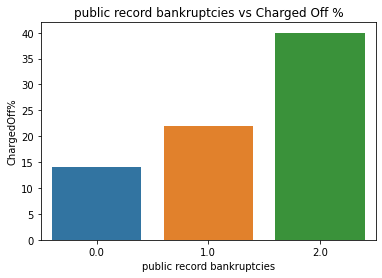

In [216]:
#To visualise the chances of charge off 
sns.barplot(x='records', y='ChargedOff%', data=bucket_df)
plt.xlabel('public record bankruptcies')
plt.title('public record bankruptcies vs Charged Off %')
plt.show()

Observation:
Borrowers with 2 public record bankruptcies pose a risk of 40% chance of being defaulted.
Whereas the borrowers with one public record bankruptcy have a 22% chance of their lone being charged off.

__Observations from Segmented Univariate Analysis:__

1. Most number of ChargedOff loans are applied for amounts between 5000 and 15000.
There is a 29% chance that a loan can be charged off for the loan amount applied between 26600 and 29500.
Even though less number of loans are taken in the range 20800 to 29500, On an average there is more than 23% chance that a loan can be charged off among the loans applied for this amount.


2. Most number of charged off loans are funded between the range 900 to 15000.
There is a 27% chance of charge off if the funded amount is in the range 24890 to 27600
Although less number of loans are taken, there is a greater chance of charge off for amounts above 16760


3. There is a 25% chance that a loan can be charged off for a term of 60 months whereas there is a 11% chance of charge off for a 36 month term.


4. Most number of charged off loans are taken at a interest rate between 11.11 and 16.00
There is a 39% chance of charge off if the interest rate is between 19.3 and 22.1
Although less number of loans are taken at a interest rate above 19.3, there is a greater chance of charge off in this case.
Median of interest rate in Charged off loans is 13.5% which is way above than that of interest in fully paid loans(11%)


5. The risk can be inferred according to the grade as G>F>E>D>(C=A)>B, Borrower with grade 'G' having the highest chance to go default and borrower of grade 'B' with relatively lower chances.


6. Borrower with A1 subgrade has the highest chance(45%) to be charged off among Grade A
Borrower with B1 subgrade has a bit higher chance(16%) to be charged off among Grade B
Borrower with C1 subgrade has the lowest chance(12%) to be charged off among Grade C
Borrower with D4 subgrade has a bit higher chance(17%) to be charged off among Grade D
Borrower with E3 and E5 subgrades have a higher chance(20%) to be charged off among Grade E
Borrower with F4 subgrade has a bit higher chance(17%) to be charged off among Grade F
Borrower with G5 subgrade has the highest chance(44%) to be charged off among Grade G


7. Borrowers with employment length either above 10 years or <1 year have the highest chance to be charged off.


8. Borrower with Home ownership type 'OTHER' has the highest chance to be charged off


9. Most number of charged off loans are applied by the borrowers with annual income between 36000 and 67074
There is a high chance of charge off if the borrower's income is below 30699
There is a low chance of charge off if the borrowers income is above 84100
The median of charged off borrower's income falls in the range 30699 and 57398, which has a bit higher chance of charge off.


10. Though the number of loans that are charged off does not have their Income verified, there is a greater chance of charge off(17%) even when the Income source of the borrower is verified.


11. The Number of charged-off loans keeps increasing each year as the number of loans issued also increased.
But there were more of loans that were charged off in 2007 and 2008 as well, along with 2011.
There were relatively lesser charged off loans issued in the years 2009 and 2010.


12. Highest loan defaults occured for the loans issued in the months of May, October and December.
More density of charged off loans can be observed in the last quarter of the year.
Lowest loan defaults are recorded for the loans issued in the month of February.


13. Majority of the loans taken for the purpose of 'Renewable Energy' are charged off.
The lowest chance of defaulters were having the loan with 'car' or 'medical' purpose.


14. Tennessee is the state with Highest possible chance for a loan defaulter.
Idaho, Minnesota are also the states with a bit more chance for defaulters.
Though California has more records of defaulters, the chance for loan defaults is above the average.


15. Though there are more charged off loans for a dti ratio between 0 to 10 compared to the ratio of 20 to 30, but the chance of the borrower being default is lesser relatively.
dti ratio greater than 20 attracts more chance of being default
The median lies in between dti ratio of 10 to 20 and has a 15% chance of being charged off


16. As the number of inquiries increases, the chance of charge off also increases, except for 4-5 inquiries, where there was a small dip.
If the inquiry requests made in the last 6 months are greater than 6, such loans of borrowers have about 30% chance of being charged off.


17. Borrowers with atleast one derogatory public record have a 22% chance of defaulting.
Whereas the chance of a borrower with no derogatory public records is 14%


18. Borrowers with 2 public record bankruptcies pose a risk of 40% chance of being defaulted.
Whereas the borrowers with one public record bankruptcy have a 22% chance of their lone being charged off.


### __A Borrower with these characteristics is highly likely to be charged off:__

1. Borrower with applied loan amount between 5000 and 15000
2. Is funded between 900 to 15000
3. Has taken a 60 month term loan
4. Loan taken with Interest rate between 19.3 and 22.1
5. Has a grade G, especially G5
6. Has a employment length less than a year or greater than ten years
7. With Home Ownership type 'OTHER'
8. Has a annual income below 30699 and the income status verified
9. Got the loan issued towards the last quarter of the year
10. Purpose of the loan is 'Renewable Energy'
11. Resident of Tennessee state
12. Has a dti ratio greater than 20
13. More than 6 inquiries made in the last 6 months
14. With atleast one derogatory public record 
15. With 2 public record bankruptcies

## Bivariate Analysis

In [217]:
df_c=df[(df.loan_status=='Charged Off')]

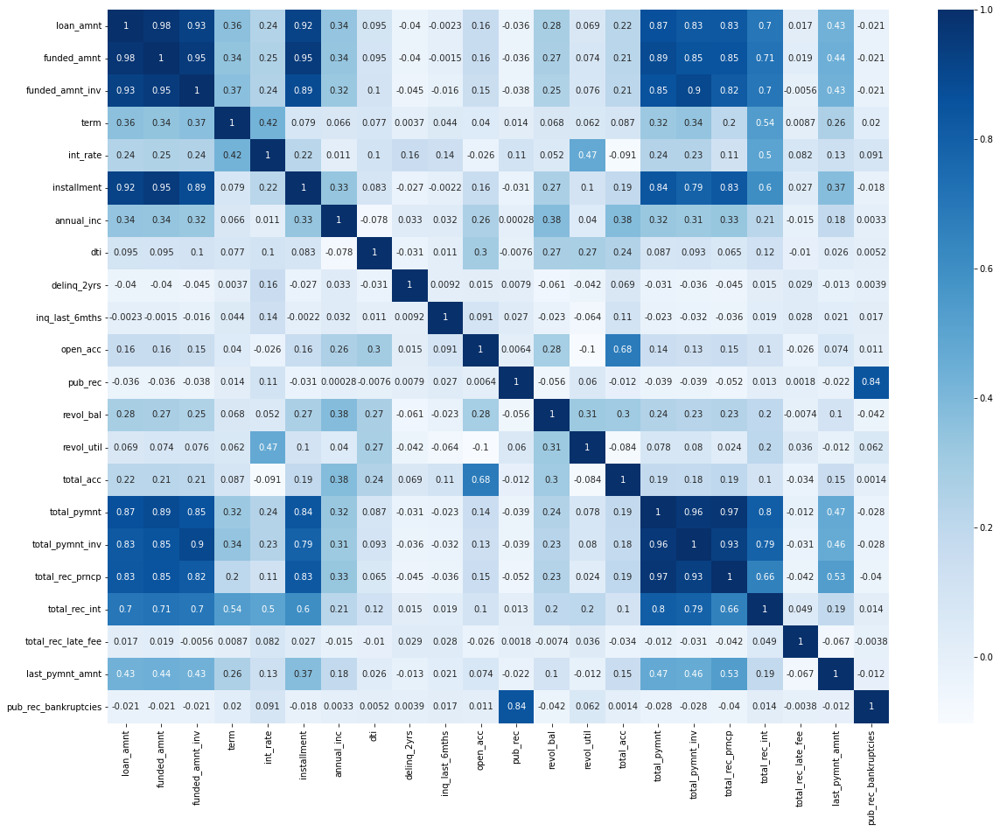

In [218]:
#Plotting a heatmap to check any correlation between numerical variables.
plt.figure(figsize=(20,15))
sns.heatmap(df.corr(), cmap='Blues', annot=True)
plt.show()

We can observe that there is high correlation between loan amount, funded amount and funded amount by investors. So we consider only 'loan amount' amongst the three for further analysis.

We can observe that total payment, installment follow the same trend as loan amount, which is obvious. As loan amount increases, total amount to be paid, installments etc., also go along the lane.

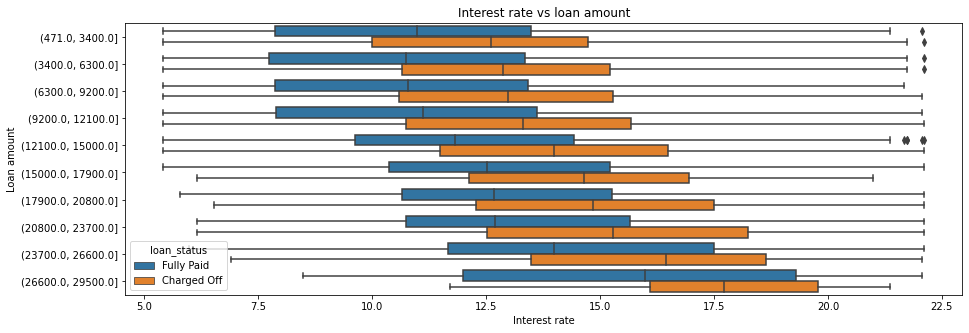

In [219]:
#Box plot for Interest rate vs loan amount
plt.figure(figsize=(15,5))
sns.boxplot(x='int_rate', y='loan_amnt_buckets', data =df, hue= 'loan_status')
plt.xlabel('Interest rate')
plt.ylabel('Loan amount')
plt.title('Interest rate vs loan amount')
plt.show()

With increasing loan amount, interest rate also increased. Around loan amount of 15000, the interest rate varied greatly from 11 to 16.5, and this is where defaulters were more compared to fully paid borrowers.
Borrowers with high interest rate in their seems to be charged off in every loan ammount range.

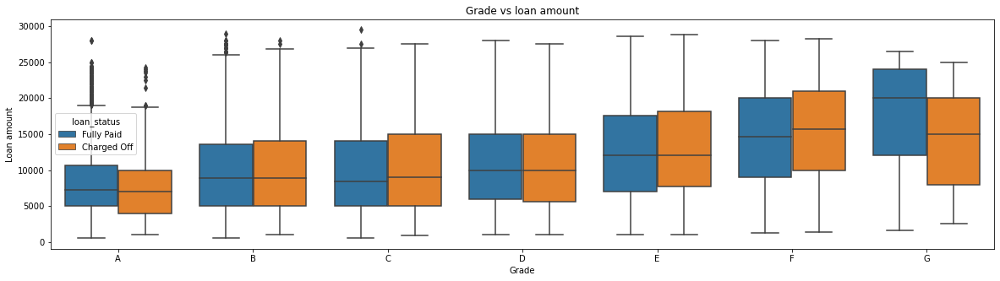

In [220]:
#Box plot for Grade vs loan amount
plt.figure(figsize=(20,5))
sns.boxplot(x=df.grade.sort_values(), y='loan_amnt', data =df, hue= 'loan_status')
plt.xlabel('Grade')
plt.ylabel('Loan amount')
plt.title('Grade vs loan amount')
plt.show()

A borrower with grade 'G' and loan amount below 20000 have the most tendency to go default.

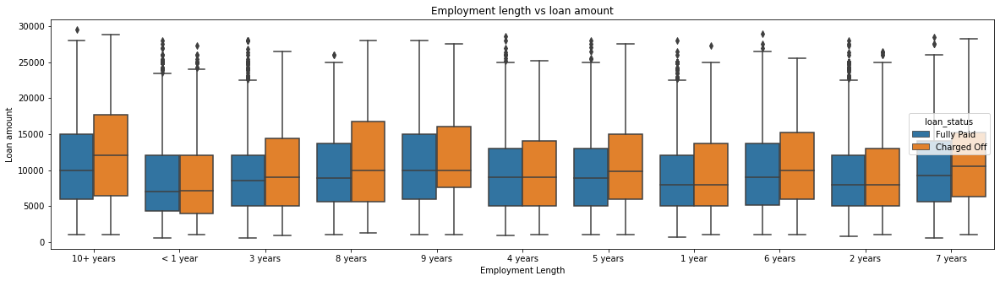

In [221]:
#Box plot for Emplyment length vs loan amount
plt.figure(figsize=(20,5))
sns.boxplot(x=df.emp_length, y='loan_amnt', data =df, hue= 'loan_status')
plt.xlabel('Employment Length')
plt.ylabel('Loan amount')
plt.title('Employment length vs loan amount')
plt.show()

Defaulters with 10+years employment length were given more amount of loan compared to that of fully paid borrowers.

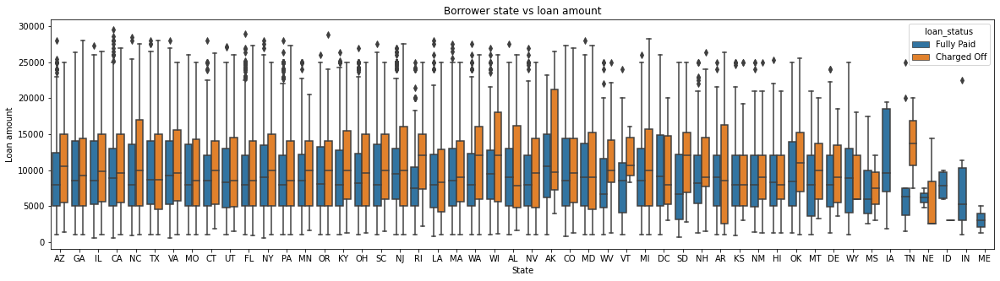

In [222]:
#Box plot for State vs loan amount
plt.figure(figsize=(20,5))
sns.boxplot(x=df.addr_state, y='loan_amnt', data =df, hue= 'loan_status')
plt.xlabel('State')
plt.ylabel('Loan amount')
plt.title('Borrower state vs loan amount')
plt.show()

Most of the borrowers from Tennessee state with loan amount greater than 7000 have gone default.

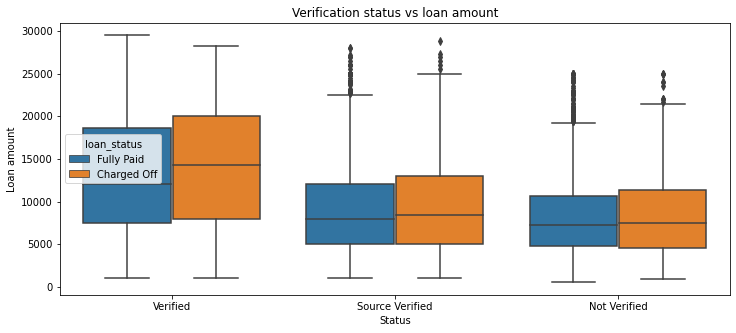

In [223]:
#Box plot for Verification Status vs loan amount
plt.figure(figsize=(12,5))
sns.boxplot(x='verification_status', y='loan_amnt', data =df, hue= 'loan_status')
plt.xlabel('Status')
plt.ylabel('Loan amount')
plt.title('Verification status vs loan amount')
plt.show()

Defaulters with verified income status were given loans with higher amounts

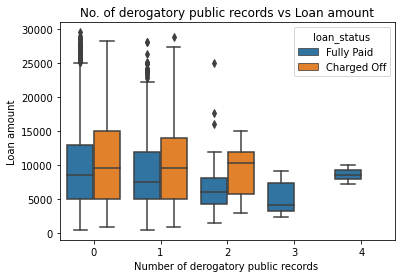

In [224]:
#loan_amnt vs pub_rec
sns.boxplot(x='pub_rec', y='loan_amnt', data =df, hue= 'loan_status')
plt.xlabel('Number of derogatory public records ')
plt.ylabel('Loan amount')
plt.title('No. of derogatory public records vs Loan amount')
plt.show()

Clearly, a loan amount greater than 10000 has more tendency to go default.

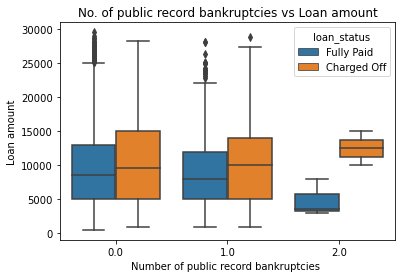

In [225]:
#loan_amnt vs pub_rec_bankruptcies
sns.boxplot(x='pub_rec_bankruptcies', y='loan_amnt', data =df, hue= 'loan_status')
plt.xlabel('Number of public record bankruptcies ')
plt.ylabel('Loan amount')
plt.title('No. of public record bankruptcies vs Loan amount')
plt.show()

A loan amount greater than 10000 given to a borrower with 2 public record bankruptcies is going to be charged off

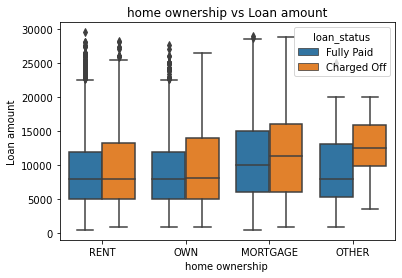

In [226]:
# home ownership vs loan amount
sns.boxplot(x='home_ownership', y='loan_amnt', data =df, hue= 'loan_status')
plt.xlabel('home ownership ')
plt.ylabel('Loan amount')
plt.title('home ownership vs Loan amount')
plt.show()

Borrowers with home ownership type 'OTHER' that are granted loans above 10000 have high chance of default.

__Observations:__

1. Borrower with loan amount below 15000 and interest rate between 11% to 16.5% has the highest chance to be charged off.
Borrowers with high interest rate in their seems to be charged off in every loan ammount range.
2. Borrower with grade 'G' and loan amount below 20000 is prone to go default.
3. Defaulters with 10+years employment length were given more amount of loan compared to that of fully paid borrowers.
4. Most of the borrowers from Tennessee state with loan amount greater than 7000 have gone default.
5. Defaulters with verified income status were given loans with higher amounts
6. A loan amount greater than 10000 has more tendency to go default.
7. A loan amount greater than 10000 given to a borrower with 2 public record bankruptcies is going to be charged off
8. Borrowers with home ownership type 'OTHER' that are granted loans above 10000 have high chance of default.

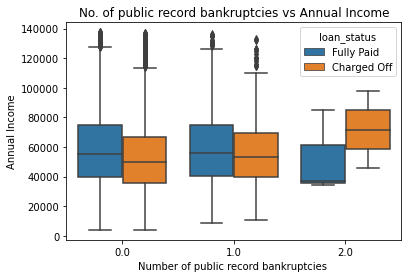

In [227]:
#annual income vs pub_rec_bankruptcies
sns.boxplot(x='pub_rec_bankruptcies', y='annual_inc', data =df, hue= 'loan_status')
plt.xlabel('Number of public record bankruptcies ')
plt.ylabel('Annual Income')
plt.title('No. of public record bankruptcies vs Annual Income')
plt.show()

Borrower with Annual Income between 60000 to 100000 with 2 public record bankruptcies is going to be charged off

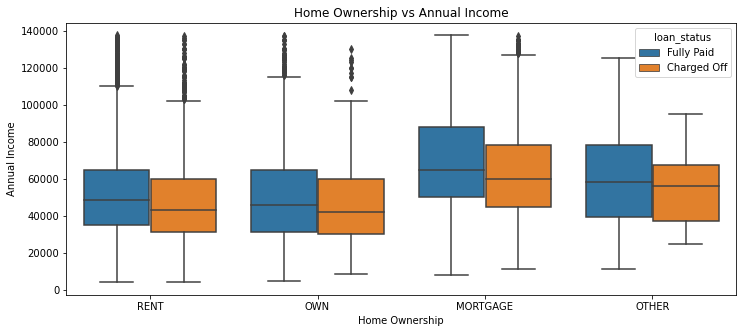

In [228]:
#Boxplot for Home Ownership vs Annual Income
plt.figure(figsize=(12,5))
sns.boxplot(x='home_ownership', y='annual_inc', data =df, hue= 'loan_status')
plt.xlabel('Home Ownership')
plt.ylabel('Annual Income')
plt.title('Home Ownership vs Annual Income')
plt.show()

Most defaulters with 'Other' home ownership type have annual income of 40000 to 70000

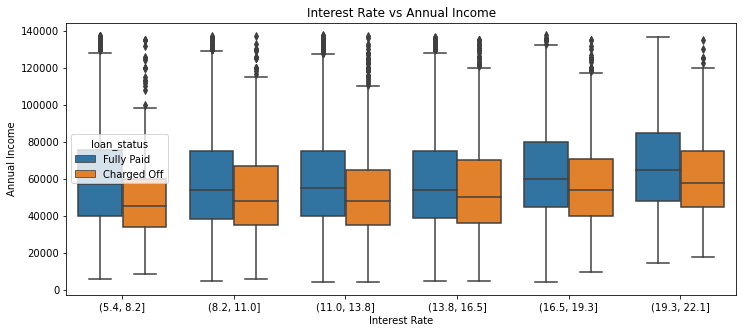

In [229]:
#Boxplot for Interest rate vs Annual Income
plt.figure(figsize=(12,5))
sns.boxplot(x='int_rate_buckets', y='annual_inc', data =df, hue= 'loan_status')
plt.xlabel('Interest Rate')
plt.ylabel('Annual Income')
plt.title('Interest Rate vs Annual Income')
plt.show()

Observation:
There is no significant change in interest rates with annual income.

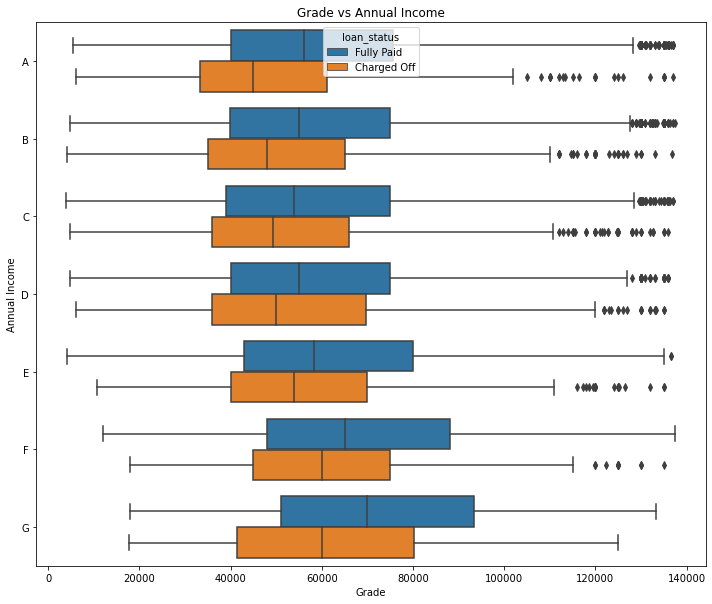

In [230]:
#Grade vs Annual Income
plt.figure(figsize=(12,10))
sns.boxplot(x='annual_inc', y=df.grade.sort_values(), data =df, hue= 'loan_status')
plt.xlabel('Grade')
plt.ylabel('Annual Income')
plt.title('Grade vs Annual Income')
plt.show()

Borrowers with Grade 'G' have relatively higher annual income and also higher chance of charge off

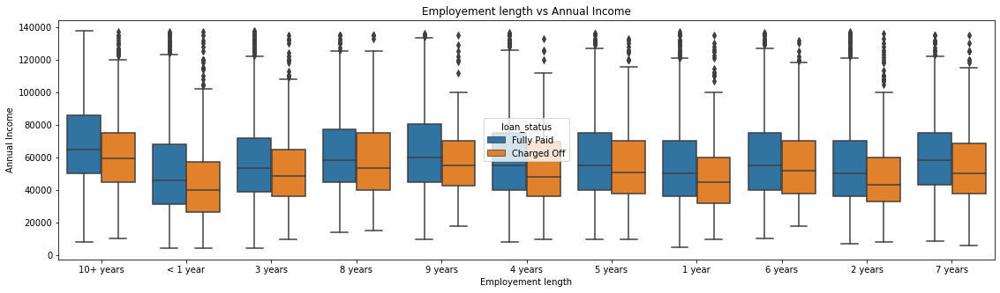

In [231]:
#Employement length vs Annual Income
plt.figure(figsize=(19,5))
sns.boxplot(x='emp_length', y='annual_inc', data =df, hue= 'loan_status')
plt.xlabel('Employement length')
plt.ylabel('Annual Income')
plt.title('Employement length vs Annual Income')
plt.show()

Majority of the borrowers of any years of employment have median of annual income in the range of 50000 to 60000

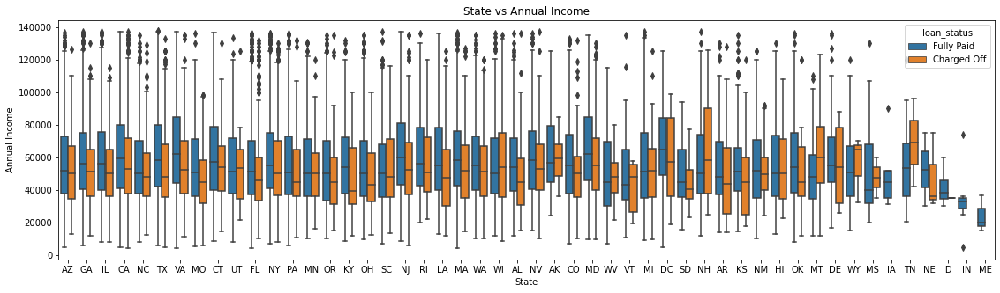

In [232]:
#State vs Annual Income
plt.figure(figsize=(19,5))
sns.boxplot(x='addr_state', y='annual_inc', data =df, hue= 'loan_status')
plt.xlabel('State')
plt.ylabel('Annual Income')
plt.title('State vs Annual Income')
plt.show()

Most of the Defaulters from Tennessee state, where there is the most tendency of charged off loans actually have annual income above 60000.

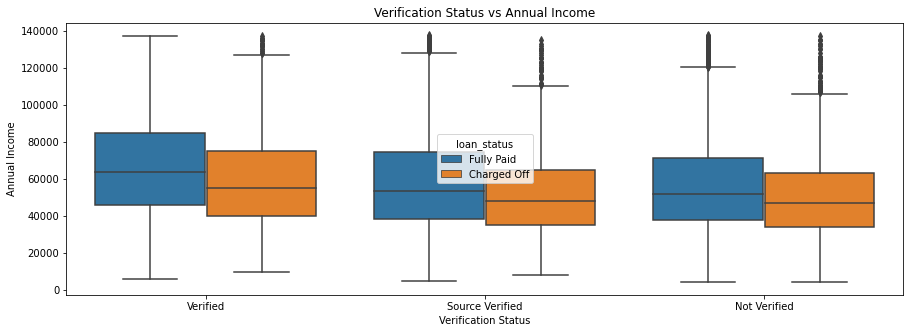

In [233]:
#verification_status vs annual_inc
plt.figure(figsize=(15,5))
sns.boxplot(x='verification_status', y='annual_inc', data =df, hue= 'loan_status')
plt.xlabel('Verification Status')
plt.ylabel('Annual Income')
plt.title('Verification Status vs Annual Income')
plt.show()

All the verification status have almost the same income range, cannot interpret much from here.

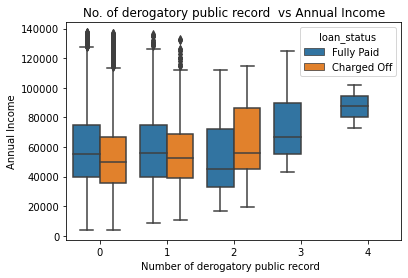

In [234]:
#annual income vs pub_rec
sns.boxplot(x='pub_rec', y='annual_inc', data =df, hue= 'loan_status')
plt.xlabel('Number of derogatory public record  ')
plt.ylabel('Annual Income')
plt.title('No. of derogatory public record  vs Annual Income')
plt.show()

Borrowers with annual income between 70000 and 90000 with 2 derogatory public records are highly likely to be charged off. 

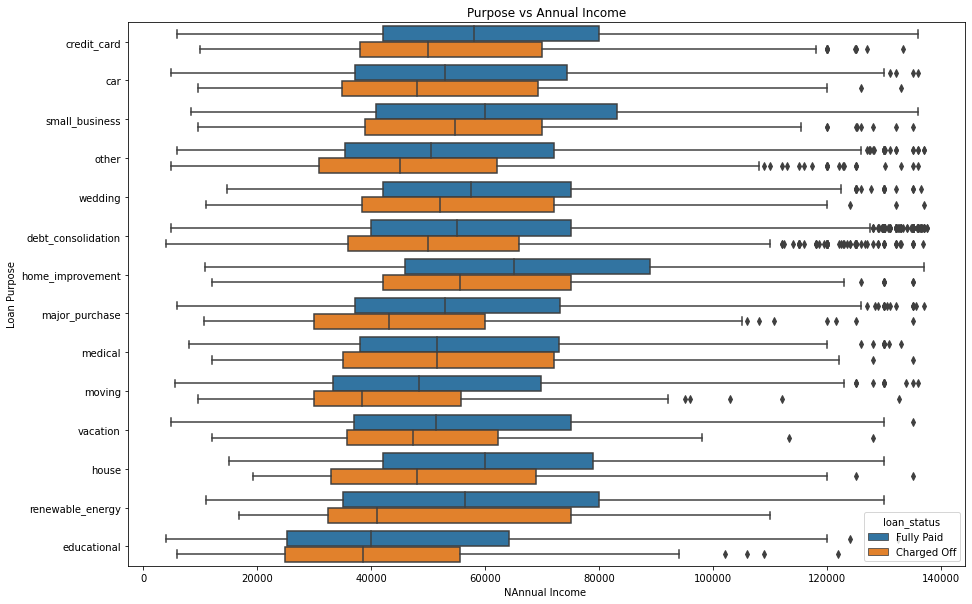

In [235]:
#annual income vs loan Purpose
plt.figure(figsize=(15,10))
sns.boxplot(x='annual_inc', y='purpose', data =df, hue= 'loan_status')
plt.xlabel('NAnnual Income ')
plt.ylabel('Loan Purpose')
plt.title('Purpose vs Annual Income')
plt.show()

Borrowers with any purpose of loan having lesser annual income are highly likely to be charged off

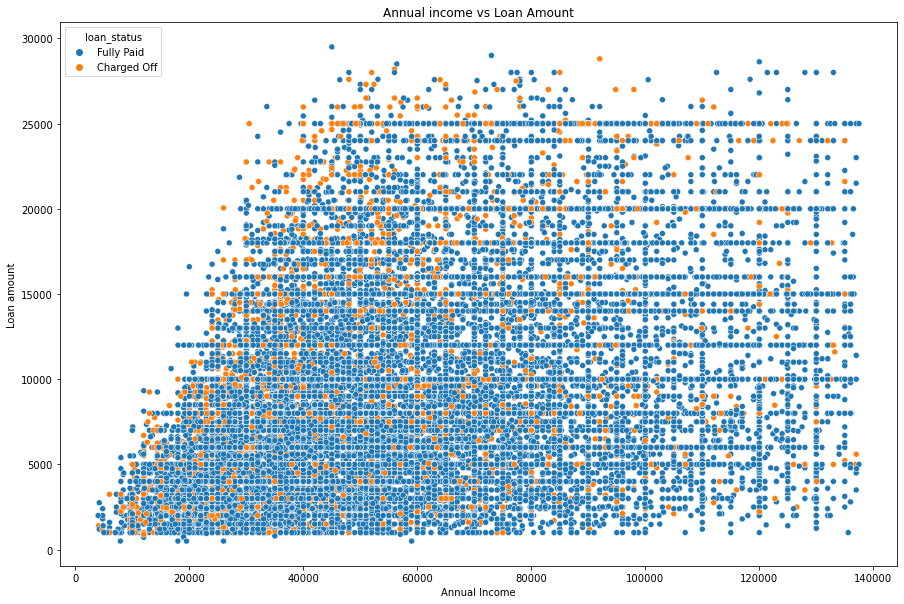

In [236]:
#annual income vs loan amount
plt.figure(figsize=(15,10))
sns.scatterplot(x='annual_inc', y='loan_amnt', data=df, hue ='loan_status')
plt.xlabel('Annual Income')
plt.ylabel('Loan amount')
plt.title('Annual income vs Loan Amount')
plt.show()

Defaulters with annual income between 40000 to 60000 have applied for higher loan amount.

__Observations:__
1. Borrower with Annual Income between 60000 to 100000 with 2 public record bankruptcies is going to be charged off
2. Most defaulters with 'Other' home ownership type have annual income of 40000 to 70000
3. Borrowers with Grade 'G' have relatively higher annual income and also higher chance of charge off
4. Majority of the borrowers of any years of employment have median of annual income in the range of 50000 to 60000
5. Most of the Defaulters from Tennessee state, where there is the most tendency of charged off loans actually have annual income above 60000.
6. Borrowers with annual income between 70000 and 90000 with 2 public record bankruptcies are highly likely to be charged off. 
7. Borrowers with any purpose of loan having lesser annual income are highly likely to be charged off
8. Defaulters with annual income between 40000 to 60000 have applied for higher loan amount.

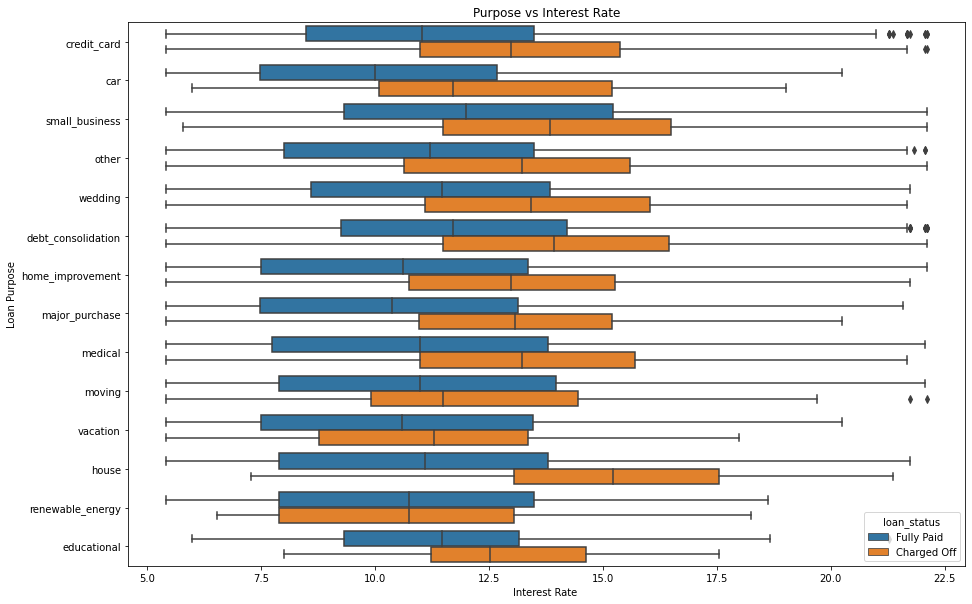

In [237]:
#Pupose vs int_rate
plt.figure(figsize=(15,10))
sns.boxplot(x='int_rate', y='purpose', data =df, hue= 'loan_status')
plt.xlabel('Interest Rate ')
plt.ylabel('Loan Purpose')
plt.title('Purpose vs Interest Rate')
plt.show()

Observations:

Defaulters are generally seen in loans taken on any purpose with higher interest rates.

Highest interest rates were charged on loans taken on the purpose of house
There are defaulters for loans taken with the purpose of renewable energy even though the interest rates are relatively lower.

## Conclusion:

There is a high chance of default when:

1. Borrower has applied loan amount between 26600 and 29500 or has annual income between 40000 to 60000 have applied for higher loan amount.
2. Loan Is funded between 900 to 15000.
3. Has taken a 60 month term loan.
4. Loan taken with Interest rate between 19.3 and 22.1 in general or loan taken below 15000 between interest rate of 11% to 16%.
5. Has a grade G with a higher annual income or loan amount below 20000, especially G5.
6. Has a employment length less than a year or greater than ten years or with a median annual income between 50000 to 60000.
7. With Home Ownership type 'OTHER' with a annual income of 40000 to 70000
8. Has a annual income below 30699 and the income status verified
9. Got the loan issued towards the last quarter of the year
10. Loan taken on any purpose with high interest rate tends to be defaulted. But loans on 'Renewable Energy' are charged off even though they were given at a lower interest rate. 
11. Resident of Tennessee state with loan amount greater than 7000 or with have annual income above 60000.
12. Has a dti ratio greater than 20
13. More than 6 inquiries made in the last 6 months
14. With atleast one derogatory public record or with an annual income between 70000 and 90000 with 2 derogatory public records.
15. With 2 public record bankruptcies with loan amount greater than 10000.